# Analyzing Spectral Reflectance within Intertidal Zones

**Summary**
This tutorial demonstrates how to use Earth observation data from NASA's ECOSTRESS and EMIT missions alongside in situ spectral reflectance measurements to investigate environmental conditions and biodiversity in the intertidal zones of Southern California. Specifically, this notebook focuses on analyzing the variability of shorelines by analyzing the coefficient of variation and testing the hypothesis within the interridal zones: Greater Coefficient of Variation = Greater Variability

We aim to better understand how spectral signatures correspond to observable biological patterns by integrating:

- ECOSTRESS LST and emissivity layers (including LST, cloud mask, and quality control flags)

- EMIT full-band Level 2A reflectance data, and

- Normalized field-collected spectral data

Ultimately, the goal is to support coastal monitoring and climate adaptation efforts by incorporating various NASA missions

**Learning Objectives**

- What is spectral diversity and how does it relate to biodiversity?
- Does a greater coefficient of variation = more variability within the intertidal zones?
- How to prepare and analyze reflectance data sets from on-ground and satellite observations. 
- Compare spectral diversity across sites and sensor types using summary statistics and visual plots.

**This Code Assumes You Have:**
- One normalized CSV for field reflectance - in situ data
- One .geojson polygon file for ROI - Created through coordinates or a polygon mapped in QGIS/ArcGIS
- ECOSTRESS and EMIT granules .txt file from VITALS Tutorial 1

**Relevant Links**
- Process data for analysis: https://github.com/kyla-mbc/Intertidal/blob/main/DataProcess.ipynb
- To process .sed data from instrument to csv: https://github.com/kyla-mbc/Intertidal/blob/main/PythonCode/SED.py
- To normalize raw spectra csv: https://github.com/kyla-mbc/Intertidal/blob/main/PythonCode/SED.py
- To manually download EMIT / ECOSTRESS Data: https://ecostress.jpl.nasa.gov/downloads/tutorials/06-Downloading_from_AppEEARS.pdf
- This Jupyter Notebook would not be possible without the help and structure of the VITALS tutorials to find and analyze concurrent ECOSTRESS and EMIT data: https://github.com/nasa/VITALS/tree/main


_______________________________________________________________________________________________________________________________________________________

## Part 1: Data Setup and Dependencies

Create a working environment with required packages. Be sure to active your environment and choose the right kernel each time you work on your project.

In [7]:
#Run in Terminal: mamba create -n (environmentname) -c conda-forge --yes python=3.12 gdal fiona hvplot geoviews rioxarray rasterio jupyter geopandas earthaccess jupyter_bookeh h5py h5netcdf spectral sckit-image jupyterlab seaborn dask ray-default pystac-client odc-stac pyresample libgal-hdf4 harmony-py

# Setup & Imports
import warnings
warnings.filterwarnings("ignore")

# Import required libraries
import os
import json
import folium
import earthaccess
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import cartopy.crs as ccrs
import numpy as np
import xarray as xr
import rioxarray as rxr
import requests
import math
from osgeo import gdal
import rasterio as rio
import hvplot.xarray
import hvplot.pandas
import holoviews as hv

from branca.element import Figure
from shapely.geometry import MultiPolygon, Polygon, box
from shapely.geometry.polygon import orient
from datetime import timedelta
from earthaccess import DataGranules
from pathlib import Path
from tqdm.notebook import tqdm
from modules.emit_tools import emit_xarray, spatial_subset, ortho_xr

%matplotlib inline


### Part 1a: NASA Earthdata Authentication

To access data from NASA Earthdata, you must first authenticate using the earthaccess library. Follow the interactive login prompt that appears to sign in with your NASA Earthdata credentials (email and password associated with your Earthdata account). This step ensures you have authorized access to download and search Earth observation datasets.

If you haven’t registered yet, create a free account here: https://urs.earthdata.nasa.gov/users/new

In [8]:
# Authenticate with NASA Earthdata
auth = earthaccess.Auth()
auth.login(strategy="interactive", persist=True)
print('Authenticated:', auth.authenticated)

Authenticated: True


### Part 1b: Define Paths 
In order to put all the data together (ECOSTRESS, EMIT, in situ), it is helpful to know where they are all located and assigning them to variables will help especially with longer file names. To download data for concurrent ECOSTRESS and EMIT data, refer to Intertidal.ipynb jupyter notebook.

You may not use all the paths or all of them at once, but it is good to have them organized. 

In [10]:
# Define Paths
#Base Path
base_dir = Path("/Users/kylamonique/Desktop/JPLFiles/PythonCode") # Common folder for all inputs and outputs. 

#In Situ Information
#Normalized csv files
LCDMground_truth_csv = Path("/Users/kylamonique/Desktop/JPLFiles/NormalizedOutputs/LCDMNormalized.csv") #Normalized in situ csv for analysis.
SDground_truth_csv = Path("/Users/kylamonique/Desktop/JPLFiles/NormalizedOutputs/SDNormalized.csv")
PVground_truth_csv = Path("/Users/kylamonique/Desktop/JPLFiles/NormalizedOutputs/PVNormalized.csv")

#ROI Polygons 
LCDMPolygon = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/LCDMPolygon.geojson")
SDPolygon = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/SDPolygon.geojson")
PVPolygon = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/PVPolygon.geojson")

#ROI Quadrats in situ
LCDMQuadrat = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/LCDMQuadrat.geojson") 
SDQuadrat = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/SDQuadrat.geojson")
PVQuadrat = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/PVQuadrat.geojson")

#if only using one site, use these variables / paths instead. 
# roi_path = Path("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/LCDMPolygon.geojson") #Region of Interest - Polygon
# roi_point=Path("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/LCDMQuadrat.geojson") #Region of Interest - Quadrat Points

#ecostress and emit data - LCDM 
ecostress_tif_pathLCDM  = Path("/Users/kylamonique/Desktop/JPLFiles/PythonCode/ECOSTRESS_Data/LCDM") #ECOSTRESS .tif folder (optional if not using earthdata)
emit_nc_pathLCDM = Path("/Users/kylamonique/Desktop/JPLFiles/PythonCode/ECOSTRESS_Data/LCDM/PythonCode/ECOSTRESS_Data/LCDM/LCDM_ECO_L2T_LSTE.002_70m_aid0001_11N.nc")  # <-- Update this if your filename is different

#ecostress and emit data - San Diego
ecostress_tif_pathSD = Path("/Users/kylamonique/Desktop/JPLFiles/PythonCode/ECOSTRESS_Data/LCDM") #ECOSTRESS .tif folder (optional if not using earthdata)
emit_nc_pathSD = Path("/Users/kylamonique/Desktop/JPLFiles/PythonCode/ECOSTRESS_Data/LCDM/PythonCode/ECOSTRESS_Data/LCDM/LCDM_ECO_L2T_LSTE.002_70m_aid0001_11N.nc")  # <-- Update this if your filename is different

#ecostress and emit data - Palos Verdes
ecostress_tif_pathPV = Path("/Users/kylamonique/Desktop/JPLFiles/PythonCode/ECOSTRESS_Data/LCDM") #ECOSTRESS .tif folder (optional if not using earthdata)
emit_nc_pathPV = Path("/Users/kylamonique/Desktop/JPLFiles/PythonCode/ECOSTRESS_Data/LCDM/PythonCode/ECOSTRESS_Data/LCDM/LCDM_ECO_L2T_LSTE.002_70m_aid0001_11N.nc")  # <-- Update this if your filename is different

# ecostress_tif_path.mkdir(exist_ok=True) #make directory if it does not exist. 


## Part 2: Visualizing Regions of Interest
It is helpful to validate whether your data was loaded in properly. Visualizing your AOI will also assist in analysis. You can either view this as a plot or through an interactive map.

       filename   latitude   longitude  Dist_Coast  Transect#  Quadrat#  \
0  IMG_2404.JPG  33.589467 -117.868247           0          1         1   
1  IMG_2405.JPG  33.589403 -117.868331          10          1         2   
2  IMG_2406.JPG  33.589353 -117.868414          20          1         3   
3  IMG_2407.JPG  33.589294 -117.868492          30          1         4   
4  IMG_2408.JPG  33.589247 -117.868592          40          1         5   

                      geometry  
0  POINT (-117.86825 33.58947)  
1   POINT (-117.86833 33.5894)  
2  POINT (-117.86841 33.58935)  
3  POINT (-117.86849 33.58929)  
4  POINT (-117.86859 33.58925)  
       filename   latitude   longitude  Dist_coast  Transect#  Quadrat#  \
0  IMG_8100.JPG  32.725650 -117.257706           0          1         1   
1  IMG_8101.JPG  32.725681 -117.257814          10          1         2   
2  IMG_8102.JPG  32.725758 -117.257897          20          1         3   
3  IMG_8104.JPG  32.725711 -117.257606           0 

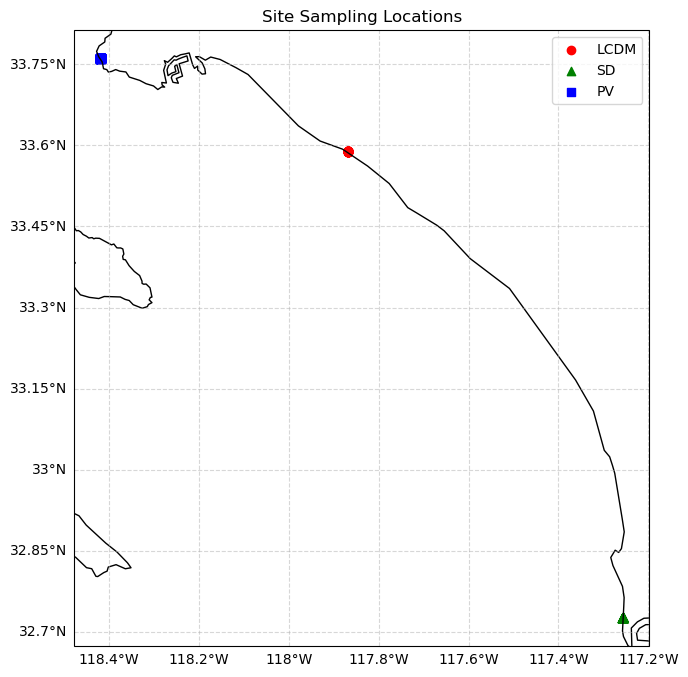

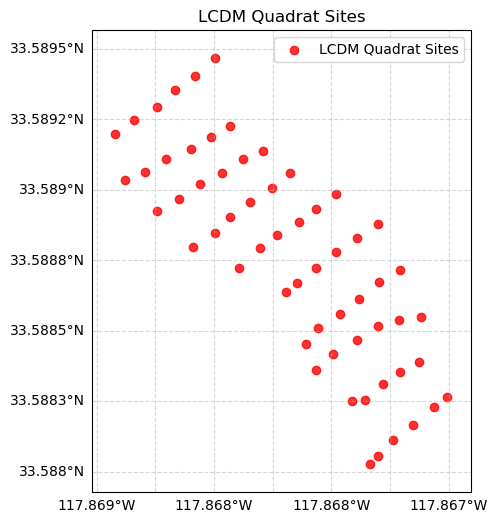

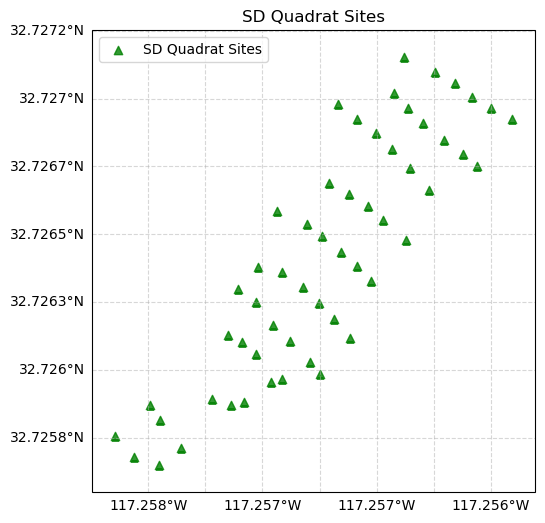

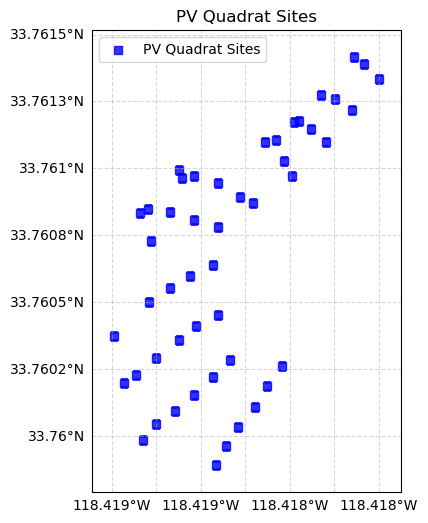

In [11]:
#Visualize Sample Locations on a Plot.
# Load GeoJSON files
print(LCDMQuadrat.head())
print(SDQuadrat.head())
print(PVQuadrat.head())

# Set up the plot with Cartopy for mapping
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Add high-resolution coastlines and gridlines
ax.coastlines(resolution='10m')
gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)
gl.top_labels = gl.right_labels = False

# Plot the GeoDataFrames
LCDMQuadrat.plot(ax=ax, marker='o', color='red', label='LCDM', transform=ccrs.PlateCarree())
SDQuadrat.plot(ax=ax, marker='^', color='green', label='SD', transform=ccrs.PlateCarree())
PVQuadrat.plot(ax=ax, marker='s', color='blue', label='PV', transform=ccrs.PlateCarree())

plt.legend()
plt.title("Site Sampling Locations")
plt.show()


# Visualize all locations within one grid.
def plot_quadrats(gdf, title, color, marker):
    fig, ax = plt.subplots(figsize=(10, 6), subplot_kw={'projection': ccrs.PlateCarree()})
    
    ax.coastlines(resolution='10m')    # Plot coastlines
    gl = ax.gridlines(draw_labels=True, linestyle='--', alpha=0.5)     # Gridlines
    gl.top_labels = gl.right_labels = False
    gdf.plot(ax=ax, color=color, marker=marker, alpha=0.8, transform=ccrs.PlateCarree(), label=title)     # Plot quadrats

    # Auto-zoom to the bounds of the GeoDataFrame (pad for clarity)
    minx, miny, maxx, maxy = gdf.total_bounds
    padding = 0.0001 # degree buffer
    ax.set_extent([minx - padding, maxx + padding, miny - padding, maxy + padding], crs=ccrs.PlateCarree())

    # Title and legend
    plt.title(title)
    plt.legend()
    plt.show()


# Visualize each location separately
#Coasts will not be visible due to space constraints.
plot_quadrats(LCDMQuadrat, "LCDM Quadrat Sites", "red", "o") 
plot_quadrats(SDQuadrat,   "SD Quadrat Sites",   "green", "^")
plot_quadrats(PVQuadrat,   "PV Quadrat Sites",   "blue", "s")


Alternatively, you could also plot your ROIs as well as the quadrats within them through an interactive map. 

On the top right corner of the map, you can toggle on and off the various layers of the map.

In [12]:
#Visualize Sample Locations on an Interactive Map.

# Load all 3 ROI polygon GeoJSONs
LCDMpolygon = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/LCDMPolygon.geojson")
SDpolygon   = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/SDPolygon.geojson")
PVpolygon   = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/PVPolygon.geojson")

#Load points within locations
LCDM_points = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/LCDMQuadrat.geojson")
SD_points   = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/SDQuadrat.geojson")
PV_points   = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/PVQuadrat.geojson")


# Combine to get a universal bounding box
combined = gpd.GeoDataFrame(pd.concat([LCDMpolygon, SDpolygon, PVpolygon], ignore_index=True), crs=LCDMpolygon.crs)
bbox = combined.total_bounds  # [minx, miny, maxx, maxy]
agu_bbox = gpd.GeoDataFrame(geometry=[combined.unary_union.envelope], crs=combined.crs)

# Create interactive map using folium and Google Satellite basemap
fig_roi = Figure(width="750px", height="375px")
map_roi = folium.Map(
    tiles='https://mt1.google.com/vt/lyrs=y&x={x}&y={y}&z={z}', 
    attr='Google Satellite', 
    name='Google Satellite'
)
fig_roi.add_child(map_roi)

# Add bounding box layer
folium.GeoJson(
    agu_bbox,
    name='Bounding Box'
).add_to(map_roi)

# Add all 3 polygons to the map with different colors
LCDMpolygon.explore(
    m=map_roi,
    name="LCDM",
    column=None,
    style_kwds=dict(color="red", fillOpacity=0.1, weight=10),
    popup=True
)

SDpolygon.explore(
    m=map_roi,
    name="SD",
    column=None,
    style_kwds=dict(color="green", fillOpacity=0.1, weight=10),
    popup=True
)

PVpolygon.explore(
    m=map_roi,
    name="PV",
    column=None,
    style_kwds=dict(color="blue", fillOpacity=0.1, weight=10),
    popup=True
)

# Add LCDM points
for _, row in LCDM_points.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color="red",
        fill=True,
        fill_color="red",
        popup=row.get("name", "LCDM Point")
    ).add_to(map_roi)

# Add SD points
for _, row in SD_points.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color="green",
        fill=True,
        fill_color="green",
        popup=row.get("name", "SD Point")
    ).add_to(map_roi)

# Add PV points
for _, row in PV_points.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color="blue",
        fill=True,
        fill_color="blue",
        popup=row.get("name", "PV Point")
    ).add_to(map_roi)



# Add layer control toggle
map_roi.add_child(folium.LayerControl())

# Fit map bounds to the union of all 3 polygons
minx, miny, maxx, maxy = combined.total_bounds
map_roi.fit_bounds(bounds=((miny, minx), (maxy, maxx)))

# Show map
fig_roi


## Part 3: Load In Situ Data

Load in and preview the normalized in situ data set. 


In [13]:
from pathlib import Path
import pandas as pd

def load_ground_truth_csv(csv_path):
    """
    Loads a ground truth CSV file, drops columns 2–6, and displays the first few rows.

    Parameters:
        csv_path (str or Path): Path to the CSV file.

    Returns:
        pd.DataFrame or None: Returns the cleaned DataFrame if loaded, or None if file doesn't exist.
    """
    csv_path = Path(csv_path)  # Ensure it's a Path object
    if csv_path.exists():
        df = pd.read_csv(csv_path)

        # Drop columns 2–6 (index 1 to 5)
        df.drop(df.columns[1:6], axis=1, inplace=True)

        print(f"✅ Loaded and trimmed file: {csv_path.name}")
        display(df.head())
        return df
    else:
        print(f"❌ File not found: {csv_path.name}")
        return None


def load_ground_truth_csv(csv_path):
    """
    Loads a ground truth CSV file, drops columns 2–6, and displays the first few rows.

    Parameters:
        csv_path (str or Path): Path to the CSV file.

    Returns:
        pd.DataFrame or None: Returns the cleaned DataFrame if loaded, or None if file doesn't exist.
    """
    csv_path = Path(csv_path)  # Ensure it's a Path object
    if csv_path.exists():
        df = pd.read_csv(csv_path)

        # Drop columns 2–6 (index 1 to 5)
        df.drop(df.columns[1:6], axis=1, inplace=True)

        print(f"✅ Loaded file: {csv_path.name}")
        display(df.head())
        return df
    else:
        print(f"❌ File not found: {csv_path.name}")
        return None


In [14]:
# Load and preview each
LCDM_df = load_ground_truth_csv(LCDMground_truth_csv)
SD_df= load_ground_truth_csv(SDground_truth_csv)
PV_df = load_ground_truth_csv(PVground_truth_csv)

✅ Loaded file: LCDMNormalized.csv


,wavelength,1594452_00097,1594452_00098,1594452_00099,1594452_00100,1594452_00101,1594452_00102,1594452_00103,1594452_00104,1594452_00105,...,1594452_00264,1594452_00265,1594452_00266,1594452_00267,1594452_00268,1594452_00269,1594452_00270,1594452_00271,1594452_00272,1594452_00273
0,400,0.065530,0.068105,0.062954,0.115893,0.115607,0.116465,0.052653,0.055514,0.053511,...,0.127053,0.136496,0.127053,0.091570,0.082413,0.086133,0.089281,0.021462,0.024896,0.026040
1,401,0.064161,0.067242,0.060935,0.116348,0.116170,0.117389,0.052521,0.055187,0.054040,...,0.126078,0.137052,0.127786,0.091195,0.081049,0.084990,0.089758,0.021664,0.025739,0.026394
2,402,0.063914,0.067121,0.061549,0.117084,0.116330,0.117881,0.052569,0.054401,0.053697,...,0.125759,0.137644,0.128149,0.090486,0.081416,0.085159,0.089506,0.021034,0.025592,0.026390
3,403,0.064941,0.067849,0.064457,0.118009,0.116313,0.118009,0.052825,0.053552,0.052825,...,0.126248,0.137879,0.127944,0.089658,0.083115,0.086265,0.088446,0.019870,0.024474,0.025928
4,404,0.064831,0.069500,0.064265,0.118548,0.118146,0.117717,0.052859,0.053342,0.053157,...,0.127177,0.137782,0.127307,0.090151,0.082523,0.084499,0.088514,0.020519,0.024880,0.025324


✅ Loaded file: SDNormalized.csv


,wavelength,1594452_00097,1594452_00098,1594452_00099,1594452_00100,1594452_00101,1594452_00102,1594452_00103,1594452_00104,1594452_00105,...,1594452_00261,1594452_00262,1594452_00263,1594452_00264,1594452_00265,1594452_00266,1594452_00267,1594452_00268,1594452_00269,1594452_00270
0,400,0.023202,0.024802,0.026602,0.025202,0.025802,0.026602,0.070606,0.069206,0.064005,...,0.074206,0.033003,0.032003,0.031403,0.029802,0.032803,0.031403,0.038803,0.039203,0.039003
1,401,0.022961,0.023711,0.026641,0.024226,0.025020,0.027162,0.070848,0.068225,0.062745,...,0.074991,0.031446,0.031592,0.031846,0.030022,0.031413,0.030875,0.038474,0.038187,0.039438
2,402,0.022967,0.023255,0.026839,0.024357,0.025372,0.026919,0.071339,0.067467,0.061988,...,0.075751,0.030474,0.030813,0.031869,0.030300,0.030983,0.030794,0.038268,0.037953,0.039500
3,403,0.023214,0.023553,0.026942,0.025417,0.026603,0.026095,0.071845,0.067100,0.062017,...,0.076251,0.030500,0.029992,0.031347,0.030500,0.031686,0.031178,0.038125,0.038634,0.039142
4,404,0.023338,0.023292,0.025966,0.024827,0.026099,0.026827,0.071503,0.067287,0.061776,...,0.076254,0.030730,0.030253,0.030606,0.030341,0.031962,0.031299,0.037673,0.038590,0.039488


✅ Loaded file: PVNormalized.csv


,wavelength,1594452_00098,1594452_00099,1594452_00100,1594452_00101,1594452_00102,1594452_00103,1594452_00104,1594452_00105,1594452_00106,...,1594452_00246,1594452_00247,1594452_00248,1594452_00249,1594452_00250,1594452_00251,1594452_00252,1594452_00253,1594452_00254,1594452_00255
0,400,0.207173,0.198732,0.187478,0.075236,0.074624,0.068201,0.025262,0.025874,0.025813,...,0.017922,0.015598,0.009420,0.007462,0.026852,0.026118,0.029972,0.029054,0.029972,0.022632
1,401,0.207757,0.199209,0.187884,0.075441,0.074534,0.068395,0.025588,0.026075,0.025671,...,0.018094,0.015625,0.009658,0.007563,0.027193,0.026137,0.029718,0.029030,0.029898,0.022563
2,402,0.208303,0.199693,0.188356,0.075517,0.074442,0.068395,0.025575,0.026268,0.025654,...,0.017956,0.015511,0.009707,0.007496,0.027331,0.026075,0.029693,0.029024,0.029881,0.022631
3,403,0.208782,0.200139,0.188893,0.075391,0.074401,0.068206,0.025252,0.026345,0.025772,...,0.017598,0.015307,0.009528,0.007289,0.027178,0.025981,0.029885,0.029052,0.029938,0.022805
4,404,0.209191,0.200564,0.189370,0.075219,0.074366,0.068290,0.025327,0.025982,0.025797,...,0.017787,0.015275,0.009470,0.007312,0.027251,0.026121,0.029737,0.029109,0.029744,0.022739


### Part 3a: Organizing Data 

Depending on how you took your in situ data, you would want to organize your data well to make processing easier. This part of the code will:

- Melt your wide format into a long format
- Define transects and quadrats for your data. (Useful if you do not have "perfect" data sets.)

In [15]:
#Melting function to change the format of your in situ data. 
def melt_in_situ_df(df, site_name):
    """
    Converts a wide-format in situ reflectance DataFrame into long format.
    
    Parameters:
        df (pd.DataFrame): Raw wide-format DataFrame (columns: wavelength, take_1, take_2, ...)
        site_name (str): Name of the site to tag the data
    
    Returns:
        pd.DataFrame: Long-format DataFrame with columns: site, wavelength, take_id, reflectance
    """
    if df is None:
        return pd.DataFrame()  # skip empty sites
    
    melted = df.melt(id_vars=["wavelength"], var_name="take_id", value_name="reflectance")
    melted["site"] = site_name
    return melted


In [16]:
#Apply the functions
LCDM_melt = melt_in_situ_df(LCDM_df, "LCDM")
SD_melt = melt_in_situ_df(SD_df, "SD")
PV_melt = melt_in_situ_df(PV_df, "PV")

In [17]:
# Concatenate all melted data
long_df = pd.concat([LCDM_melt, SD_melt, PV_melt], ignore_index=True)
long_df.head()


,wavelength,take_id,reflectance,site
0,400,1594452_00097,0.065530,LCDM
1,401,1594452_00097,0.064161,LCDM
2,402,1594452_00097,0.063914,LCDM
3,403,1594452_00097,0.064941,LCDM
4,404,1594452_00097,0.064831,LCDM


In [18]:
# Define take-to-quadrat mapping
def build_quadrat_map(take_ids, n_quadrats, custom_take_counts=None):
    """
    Build a mapping from take_id → quadrat, taking into account custom take counts.
    """
    mapping = []
    idx = 0
    for q in range(1, n_quadrats + 1):
        count = custom_take_counts.get(q, 3) if custom_take_counts else 3
        for _ in range(count):
            if idx >= len(take_ids):
                break
            mapping.append({'take_id': take_ids[idx], 'quadrat': q})
            idx += 1
    return pd.DataFrame(mapping)

# Add transect number based on quadrat
def assign_transects(quadrat_map, quadrats_per_transect=6):
    """
    Adds a transect number to the quadrat mapping DataFrame.
    """
    quadrat_map['transect'] = ((quadrat_map['quadrat'] - 1) // quadrats_per_transect) + 1
    return quadrat_map


In [23]:
def build_quadrat_from_transects(transect_quadrat_counts):
    """
    Given a dict like {1: 6, 2: 6, 3: 4}, returns a list of dicts:
    [{'quadrat': 1, 'transect': 1}, {'quadrat': 2, 'transect': 1}, ...]
    """
    metadata = []
    quadrat_counter = 1
    for transect, n_quadrats in transect_quadrat_counts.items():
        for _ in range(n_quadrats):
            metadata.append({'quadrat': quadrat_counter, 'transect': transect})
            quadrat_counter += 1
    return pd.DataFrame(metadata)


In [24]:
#Layouts for # of quadrats within each transect
LCDM_layout = {
    1: 6, 2: 6, 3: 6, 4: 6, 5: 6, 6: 6,
    7: 6, 8: 6, 9: 6,
    10: 6
}

# PV layout: transects 1–6 have 6 quadrats, 7–9 have 4, transect 10 has 5
PV_layout = {
    1: 6, 2: 6, 3: 6, 4: 6, 5: 6, 6: 6,
    7: 4, 8: 4, 9: 3,
    10: 5
}

# SD layout:
SD_layout = {
    1: 3, 2: 3,
    3: 3, 4: 5, 5: 6, 6: 6, 7: 6,
    8: 5, 9: 6, 10: 6, 11: 6
}


In [20]:
# # Get sorted LCDM take IDs
# LCDM_take_ids = LCDM_melt['take_id'].dropna().sort_values().unique().tolist()

# # Build quadrat map with 2-take overrides
# LCDM_map = assign_transects(
#     build_quadrat_map(LCDM_take_ids, n_quadrats=60, custom_take_counts=LCDM_custom)
# )

In [ ]:
# LCDM_sorted = LCDM_melt.merge(LCDM_map, on="take_id", how="left")
# LCDM_map['quadrat'].value_counts().sort_index().head(60)


In [25]:
def build_quadrat_map_with_custom_layout(take_ids, layout_dict, custom_take_counts=None):
    """
    Maps take_ids to quadrats and transects based on layout_dict.
    """
    quadrat_meta = build_quadrat_from_transects(layout_dict)
    
    mapping = []
    idx = 0
    for row in quadrat_meta.itertuples():
        count = custom_take_counts.get(row.quadrat, 3) if custom_take_counts else 3
        for _ in range(count):
            if idx >= len(take_ids):
                break
            mapping.append({
                'take_id': take_ids[idx],
                'quadrat': row.quadrat,
                'transect': row.transect
            })
            idx += 1
    return pd.DataFrame(mapping)


In [26]:
# Get sorted take_ids
PV_take_ids = PV_melt['take_id'].dropna().sort_values().unique().tolist()
SD_take_ids = SD_melt['take_id'].dropna().sort_values().unique().tolist()
LCDM_take_ids = LCDM_melt['take_id'].dropna().sort_values().unique().tolist()

# Custom takes if any
LCDM_custom = {41: 2, 53: 2, 54: 2}
SD_custom = {}  
PV_custom = {}  

# Build mapping tables
LCDM_map = build_quadrat_map_with_custom_layout(LCDM_take_ids, LCDM_layout, LCDM_custom)
SD_map = build_quadrat_map_with_custom_layout(SD_take_ids, SD_layout, SD_custom)
PV_map = build_quadrat_map_with_custom_layout(PV_take_ids, PV_layout, PV_custom)

# Merge into full datasets
LCDM_sorted = LCDM_melt.merge(LCDM_map, on="take_id", how="left")
SD_sorted = SD_melt.merge(SD_map, on="take_id", how="left")
PV_sorted = PV_melt.merge(PV_map, on="take_id", how="left")


In [27]:
#Ensure transects and quadrats print as integers
LCDM_sorted['quadrat'] = LCDM_sorted['quadrat'].astype('Int64')
LCDM_sorted['transect'] = LCDM_sorted['transect'].astype('Int64')

SD_sorted['quadrat'] = SD_sorted['quadrat'].astype('Int64')
SD_sorted['transect'] = SD_sorted['transect'].astype('Int64')

PV_sorted['quadrat'] = PV_sorted['quadrat'].astype('Int64')
PV_sorted['transect'] = PV_sorted['transect'].astype('Int64')


In [28]:
#Check if code to sort transects and quadrats was a success.
print("LCDM: Quadrats =", LCDM_sorted['quadrat'].nunique(), 
      " | Transects =", LCDM_sorted['transect'].nunique())

print("SD: Quadrats =", SD_sorted['quadrat'].nunique(), 
      " | Transects =", SD_sorted['transect'].nunique())

print("PV: Quadrats =", PV_sorted['quadrat'].nunique(), 
      " | Transects =", PV_sorted['transect'].nunique())


print("🔍 LCDM Sorted Preview")
display(LCDM_sorted.head())

print("🔍 SD Sorted Preview")
display(SD_sorted.head())

print("🔍 PV Sorted Preview")
display(PV_sorted.head())


LCDM: Quadrats = 60  | Transects = 10
SD: Quadrats = 55  | Transects = 11
PV: Quadrats = 52  | Transects = 10
🔍 LCDM Sorted Preview


,wavelength,take_id,reflectance,site,quadrat,transect
0,400,1594452_00097,0.065530,LCDM,1,1
1,401,1594452_00097,0.064161,LCDM,1,1
2,402,1594452_00097,0.063914,LCDM,1,1
3,403,1594452_00097,0.064941,LCDM,1,1
4,404,1594452_00097,0.064831,LCDM,1,1


🔍 SD Sorted Preview


,wavelength,take_id,reflectance,site,quadrat,transect
0,400,1594452_00097,0.023202,SD,1,1
1,401,1594452_00097,0.022961,SD,1,1
2,402,1594452_00097,0.022967,SD,1,1
3,403,1594452_00097,0.023214,SD,1,1
4,404,1594452_00097,0.023338,SD,1,1


🔍 PV Sorted Preview


,wavelength,take_id,reflectance,site,quadrat,transect
0,400,1594452_00098,0.207173,PV,1,1
1,401,1594452_00098,0.207757,PV,1,1
2,402,1594452_00098,0.208303,PV,1,1
3,403,1594452_00098,0.208782,PV,1,1
4,404,1594452_00098,0.209191,PV,1,1


## Part 4: Calculate In Situ Data

Calculate for the mean, std, and coefficient of variation for the in situ data. 

In [29]:
#Function to calculate statistics for in situ data. 
def summarize_in_situ_data(df):
    summary = (
        df
        .groupby(['site', 'transect', 'quadrat', 'wavelength'])
        .agg(
            mean_reflectance=('reflectance', 'mean'),
            std_reflectance=('reflectance', 'std')
        )
        .reset_index()
    )
    summary['cv_percent'] = (summary['std_reflectance'] / summary['mean_reflectance']) * 100
    return summary


In [30]:
#Apply to all in situ field sites. 
LCDM_summary = summarize_in_situ_data(LCDM_sorted)
SD_summary   = summarize_in_situ_data(SD_sorted)
PV_summary   = summarize_in_situ_data(PV_sorted)


In [31]:
#OPTIONAL: You can download the csv files with the outputted calculations. 
LCDM_summary.to_csv("/Users/kylamonique/Desktop/JPLFiles/PythonCode/IntertidalOutputs/LCDM_summary.csv", index=False)
SD_summary.to_csv("/Users/kylamonique/Desktop/JPLFiles/PythonCode/IntertidalOutputs/SD_summary.csv", index=False)
PV_summary.to_csv("/Users/kylamonique/Desktop/JPLFiles/PythonCode/IntertidalOutputs/PV_summary.csv", index=False)


In [32]:
#Combine all the data
all_summary = pd.concat([LCDM_summary, SD_summary, PV_summary], ignore_index=True)
all_summary.to_csv("all_sites_summary.csv", index=False)

## Part 5: Plot In Situ Spectra

In [33]:
#Plot by transect. 
import matplotlib.pyplot as plt

def plot_transect_spectra(summary_df, site_name):
    """
    Plots average reflectance spectra for each transect in a given site.
    
    Parameters:
        summary_df (pd.DataFrame): Summarized data with mean_reflectance
        site_name (str): Name of the site (e.g., "LCDM", "SD", "PV")
    """
    # Filter for this site
    site_df = summary_df[summary_df['site'] == site_name]
    
    # Group by transect and wavelength, average across quadrats
    grouped = (
        site_df
        .groupby(['transect', 'wavelength'])['mean_reflectance']
        .mean()
        .reset_index()
    )
    
    # Plot each transect
    plt.figure(figsize=(12, 6))
    for transect in sorted(grouped['transect'].unique()):
        sub = grouped[grouped['transect'] == transect]
        plt.plot(sub['wavelength'], sub['mean_reflectance'], label=f'Transect {transect}')
    
    plt.title(f"{site_name} – Mean Spectra per Transect")
    plt.xlabel("Wavelength (nm)")
    plt.ylabel("Mean Reflectance")
    plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
    plt.grid(True)
    plt.tight_layout()
    plt.show()


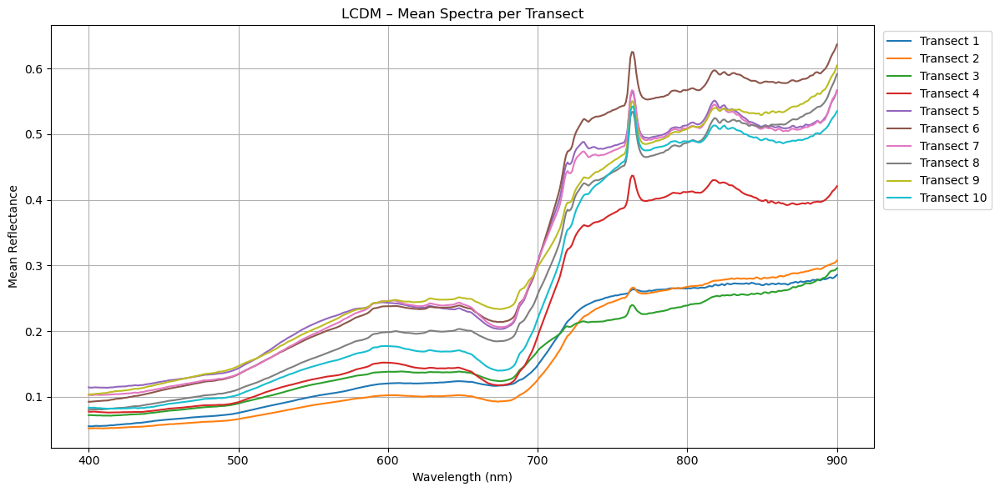

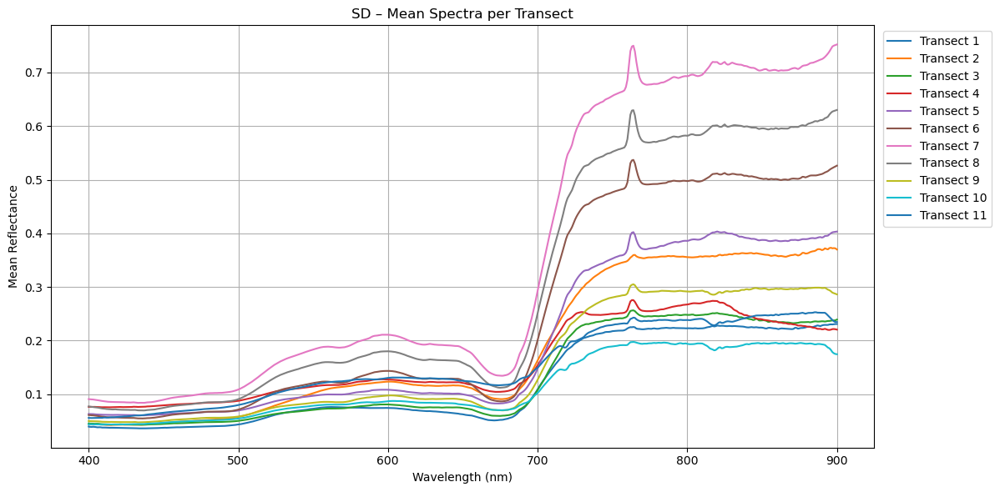

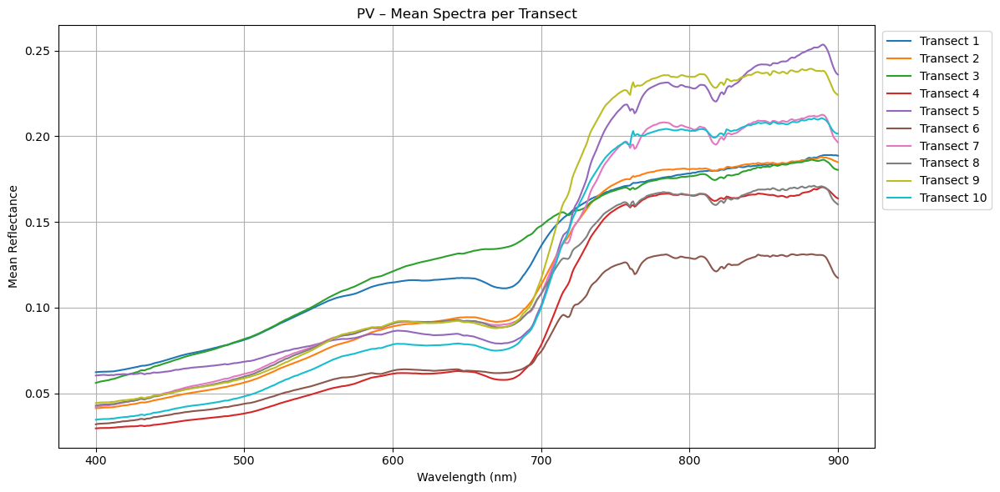

In [34]:
plot_transect_spectra(LCDM_summary, "LCDM")
plot_transect_spectra(SD_summary, "SD")
plot_transect_spectra(PV_summary, "PV")


In [36]:
#PLot by quadrat
import matplotlib.pyplot as plt

def plot_all_transects_per_site(summary_df, site_name, show=True, save=False, output_dir=".", file_format="png"):
    """
    Plots one figure per transect in the specified site. Each plot shows all quadrats in that transect.
    
    Parameters:
        summary_df (pd.DataFrame): Summary data with site, transect, quadrat, wavelength, mean_reflectance
        site_name (str): e.g., "LCDM", "SD", "PV"
        show (bool): If True, display plots
        save (bool): If True, save each figure as a file
        output_dir (str): Folder to save plots in (if save=True)
        file_format (str): "png", "pdf", etc.
    """
    site_df = summary_df[summary_df['site'] == site_name]
    transects = sorted(site_df['transect'].unique())
    
    for transect in transects:
        df = site_df[site_df['transect'] == transect]
        quadrats = sorted(df['quadrat'].unique())

        plt.figure(figsize=(10, 6))
        for q in quadrats:
            sub = df[df['quadrat'] == q]
            # Multiply reflectance by 100 to convert to percentage
            plt.plot(sub['wavelength'], sub['mean_reflectance'] * 100, label=f"Q{q}")

        plt.title(f"{site_name} – Transect {transect}")
        plt.xlabel("Wavelength (nm)")
        plt.ylabel("Mean Reflectance (%)")  # Update label to show percentage
        plt.legend(loc='upper left', fontsize='small', ncol=2)
        plt.grid(True)
        plt.tight_layout()
        
        if save:
            filename = f"{site_name}_Transect{transect}.{file_format}"
            filepath = f"{output_dir}/{filename}"
            plt.savefig(filepath, dpi=300)
        
        if show:
            plt.show()
        else:
            plt.close()


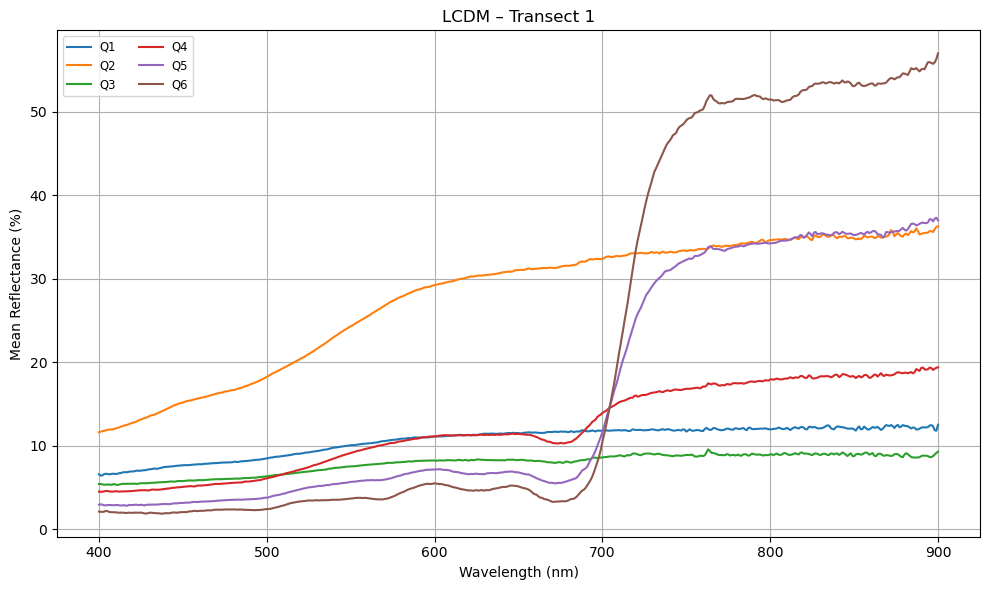

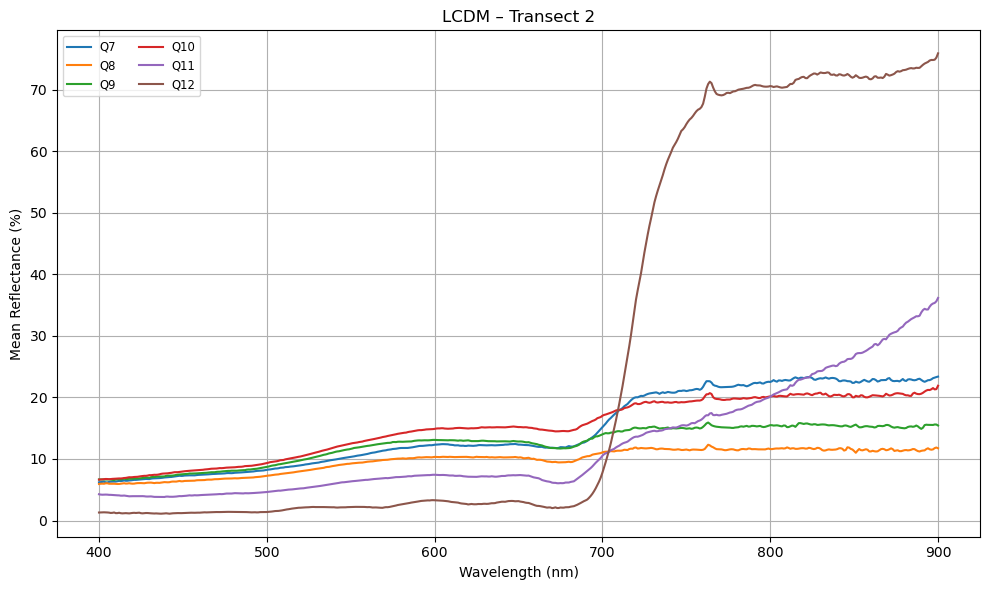

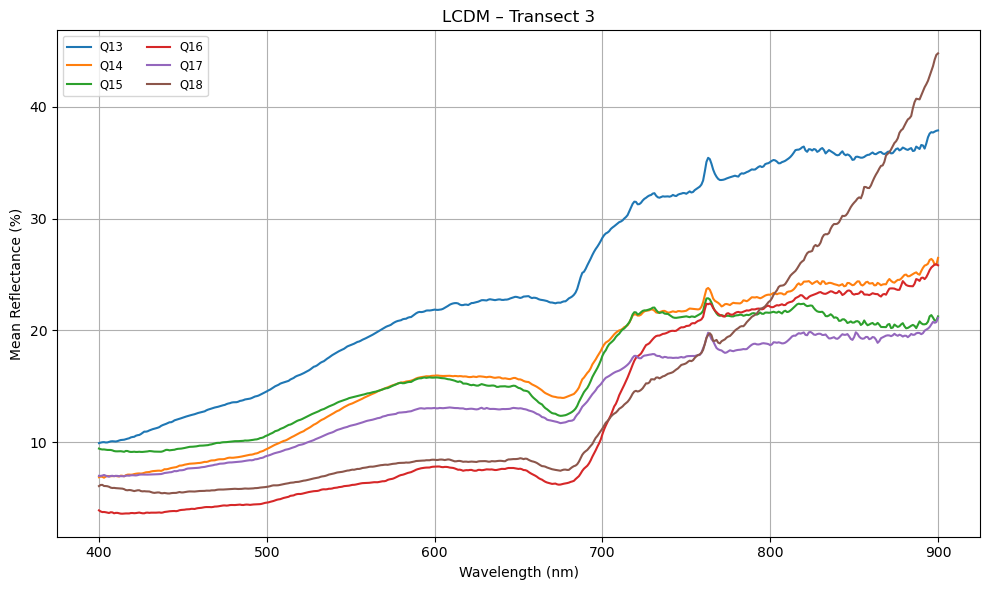

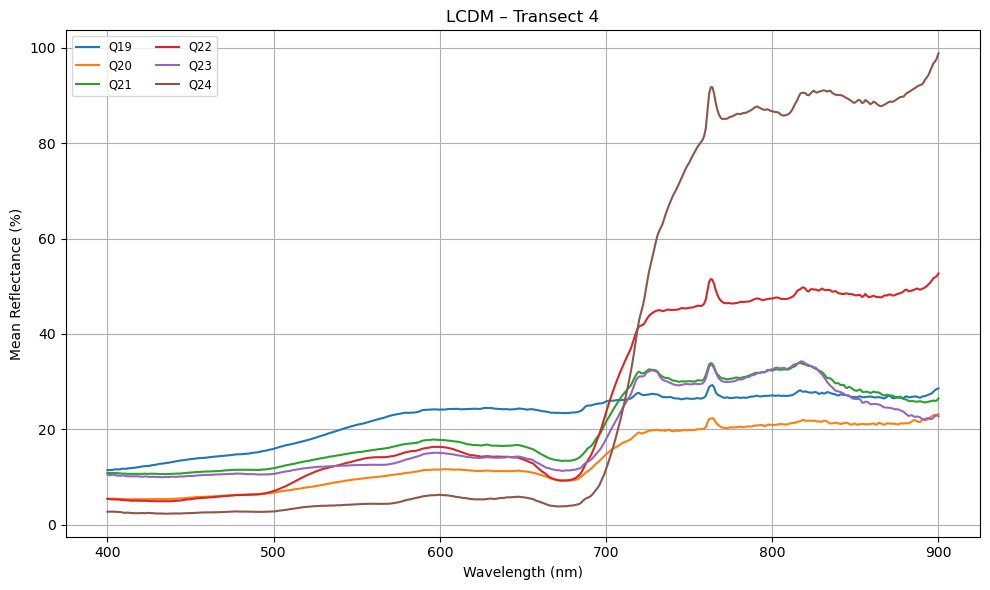

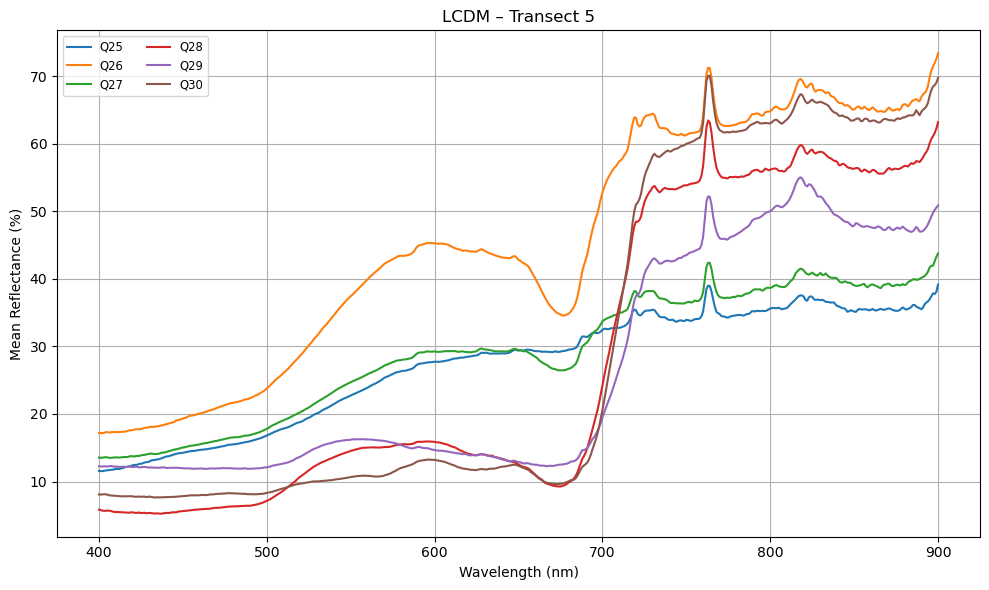

...

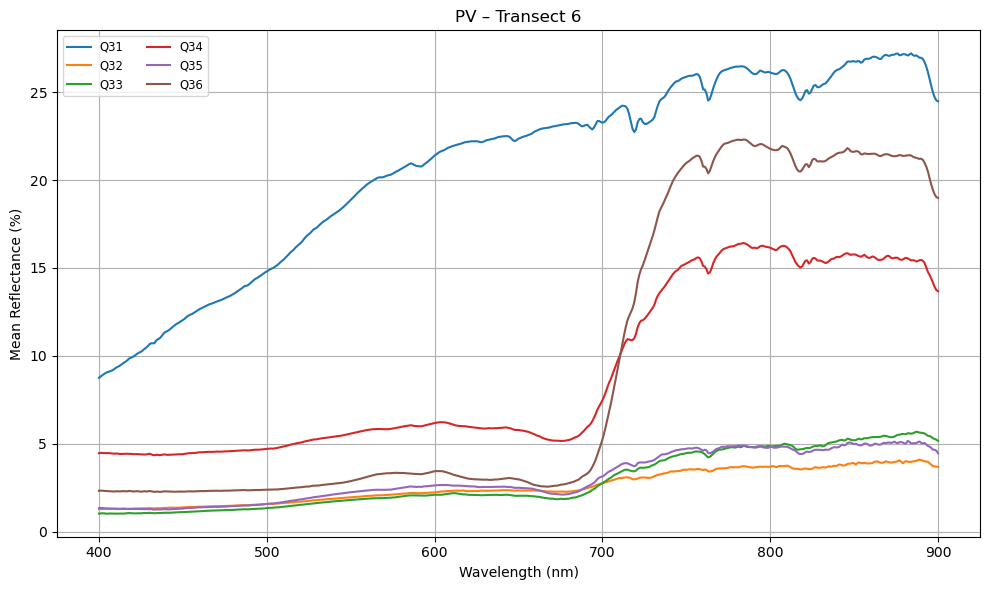

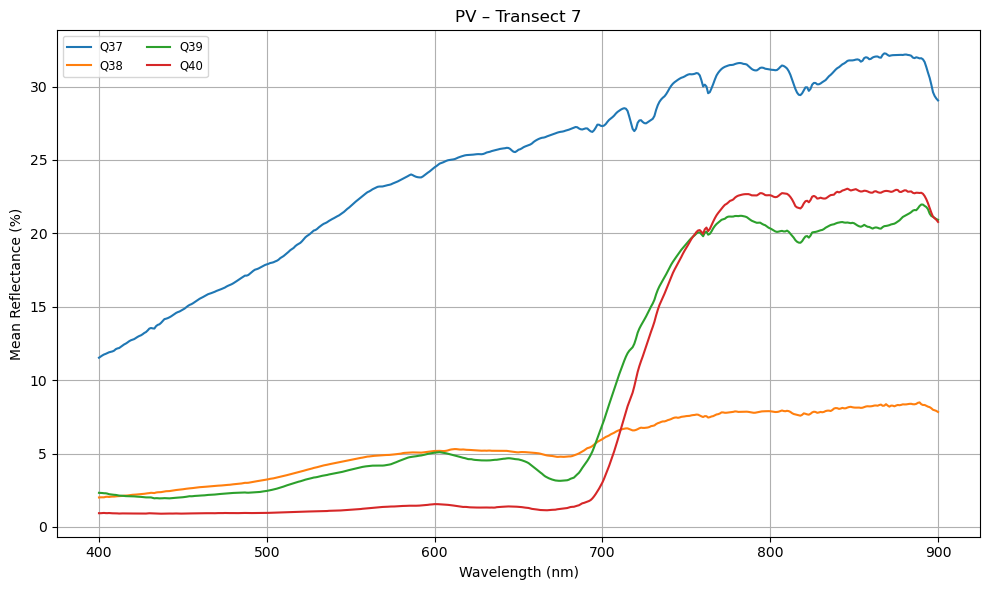

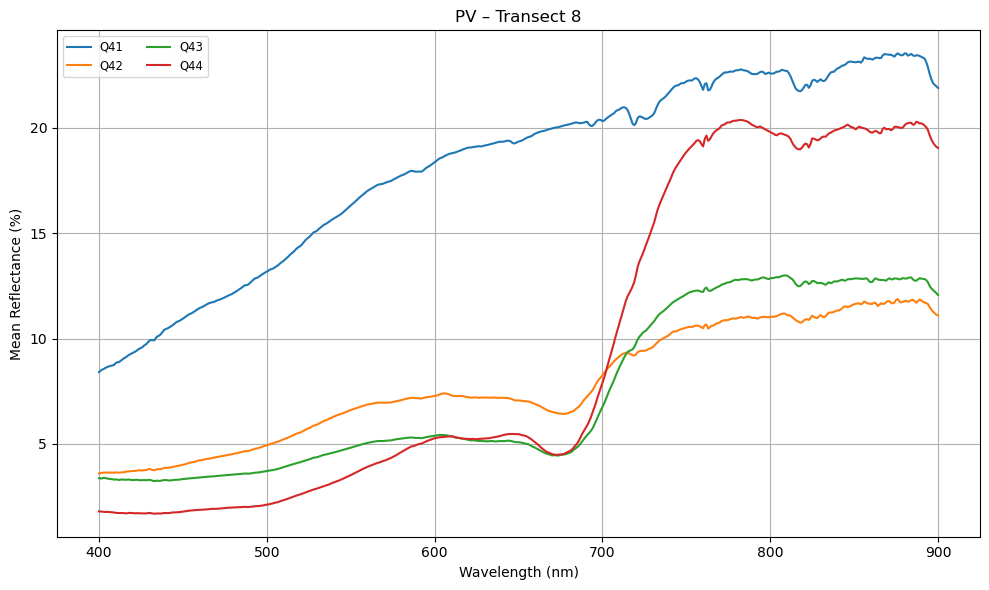

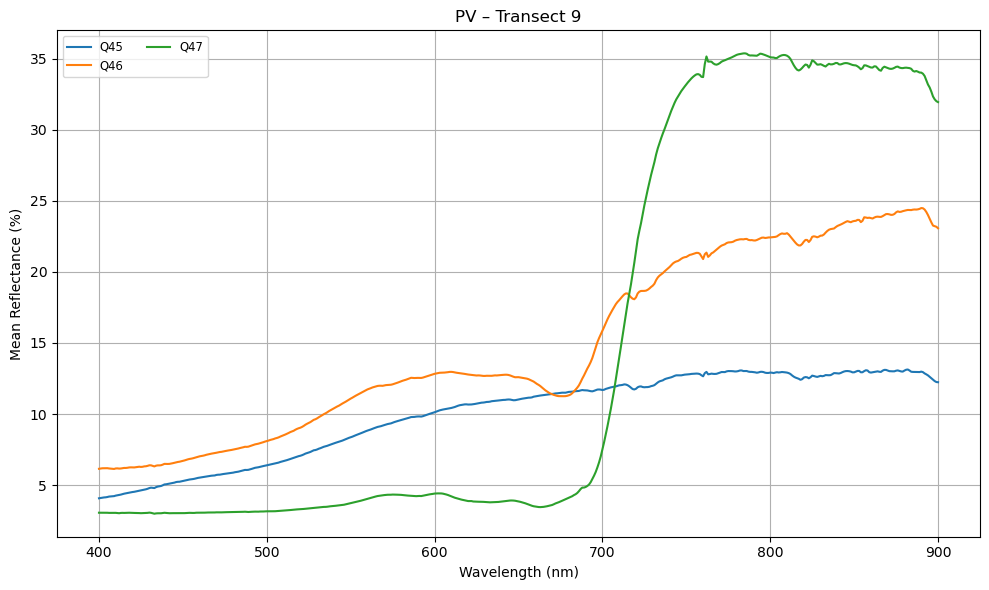

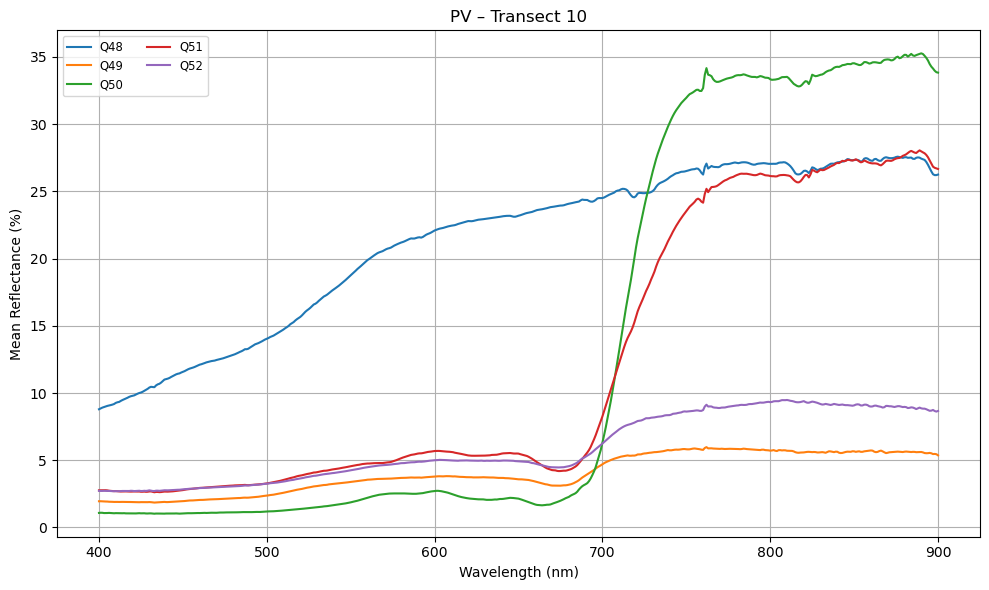

In [37]:
# Display the plots by quadrat
plot_all_transects_per_site(LCDM_summary, "LCDM")
plot_all_transects_per_site(SD_summary, "SD")
plot_all_transects_per_site(PV_summary, "PV")


In [38]:
#Plot stats by transect. 
import matplotlib.pyplot as plt

def plot_transect_with_stats(summary_df, site_name, show=True, save=False, output_dir=".", file_format="png"):
    """
    For each transect in a site:
    - Plot mean reflectance ± 1 SD
    - Plot CV (%) across wavelengths
    
    Parameters:
        summary_df (pd.DataFrame): Output of summarize_in_situ_data()
        site_name (str): e.g., "LCDM", "SD", "PV"
        show (bool): Show plots
        save (bool): Save plots
        output_dir (str): Where to save plots
        file_format (str): File format for saving
    """
    site_df = summary_df[summary_df["site"] == site_name]
    transects = sorted(site_df["transect"].unique())

    for t in transects:
        transect_df = site_df[site_df["transect"] == t]

        # Group across all quadrats in the transect
        grouped = (
            transect_df
            .groupby("wavelength")
            .agg(
                mean_reflectance=("mean_reflectance", "mean"),
                std_reflectance=("std_reflectance", "mean"),  # avg std across quadrats
                mean_cv=("cv_percent", "mean")  # avg CV across quadrats
            )
            .reset_index()
        )

        # Plot: Mean ± SD and CV%
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True, height_ratios=[3, 1])

        # Top: Mean Reflectance ± SD
        ax1.plot(grouped["wavelength"], grouped["mean_reflectance"], color="blue", label="Mean Reflectance")
        ax1.fill_between(
            grouped["wavelength"],
            grouped["mean_reflectance"] - grouped["std_reflectance"],
            grouped["mean_reflectance"] + grouped["std_reflectance"],
            alpha=0.3,
            color="blue",
            label="±1 SD"
        )
        ax1.set_ylabel("Reflectance")
        ax1.set_title(f"{site_name} – Transect {t}")
        ax1.grid(True)
        ax1.legend()

        # Bottom: CV%
        ax2.plot(grouped["wavelength"], grouped["mean_cv"], color="red", label="Mean CV%")
        ax2.axhline(20, color="gray", linestyle="--", linewidth=0.8, label="20% Threshold")
        ax2.set_ylabel("CV (%)")
        ax2.set_xlabel("Wavelength (nm)")
        ax2.grid(True)
        ax2.legend()

        plt.tight_layout()

        # Save or show
        if save:
            filename = f"{site_name}_Transect{t}_stats.{file_format}"
            plt.savefig(f"{output_dir}/{filename}", dpi=300)
        if show:
            plt.show()
        else:
            plt.close()


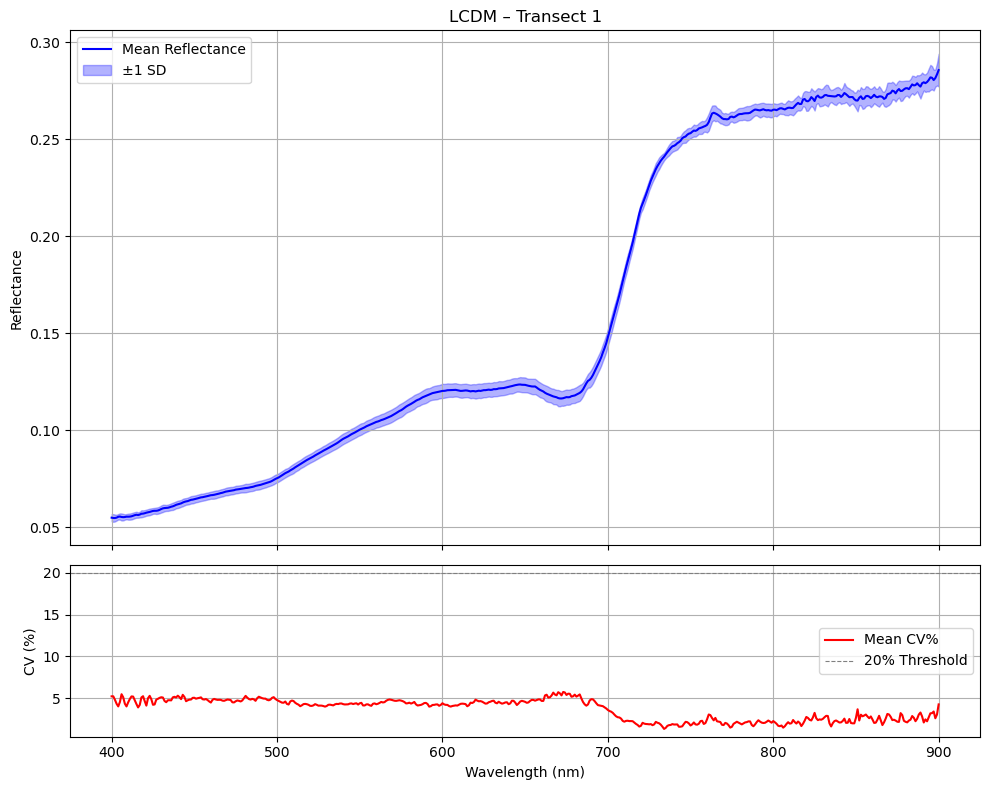

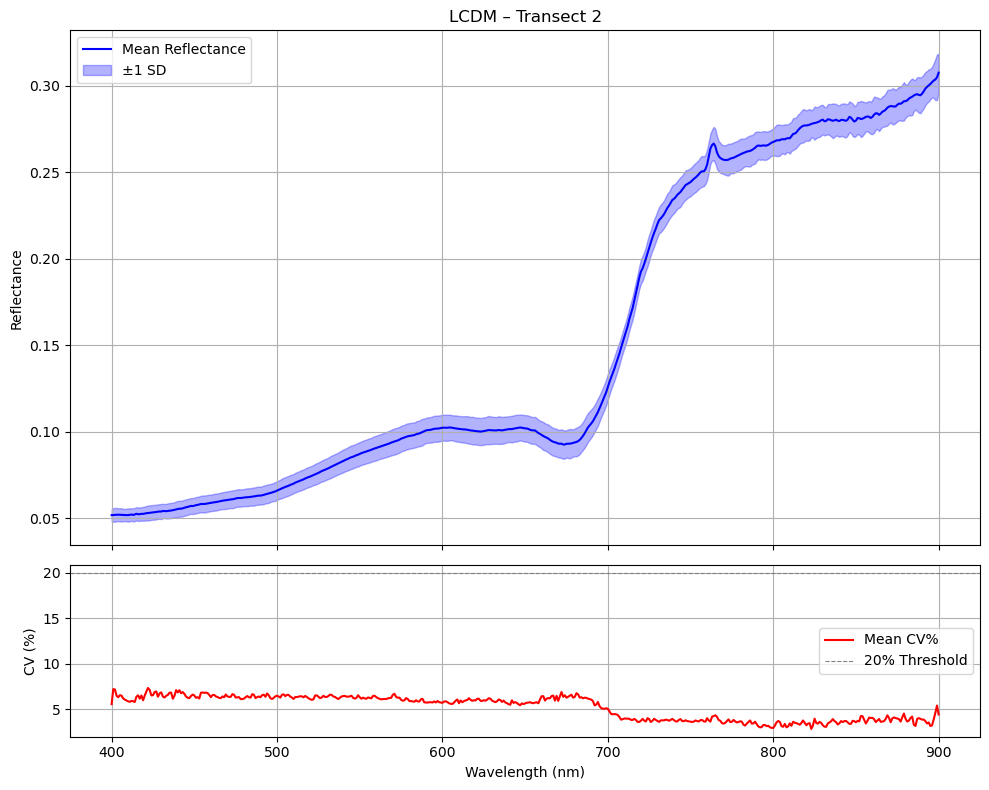

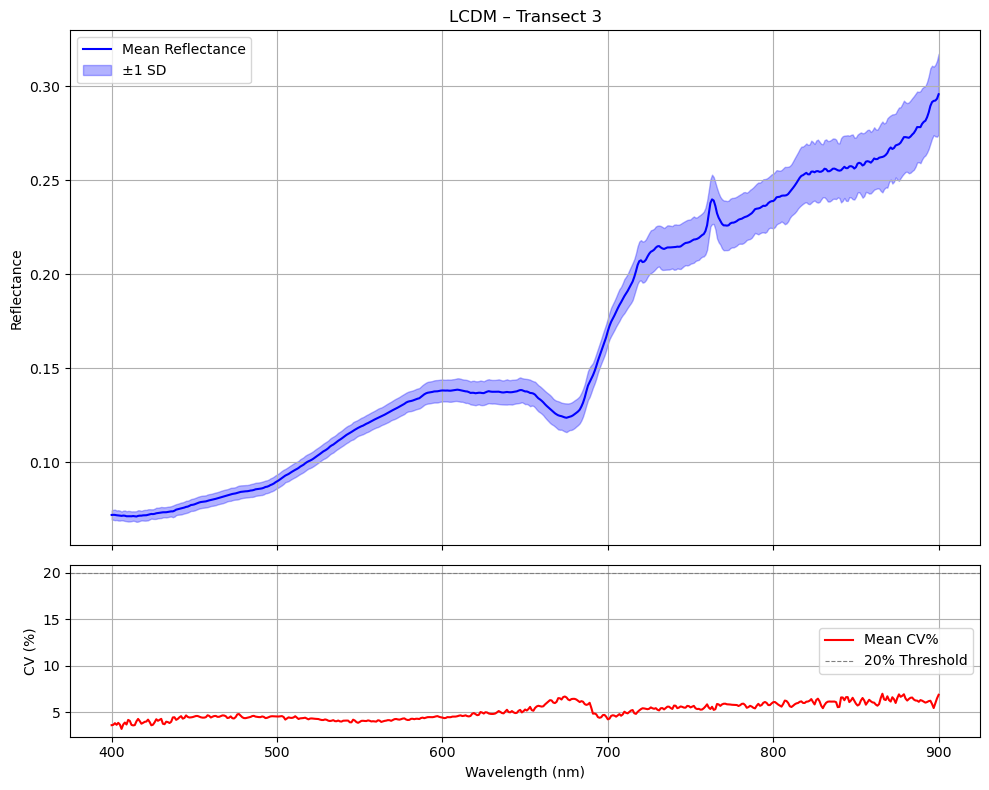

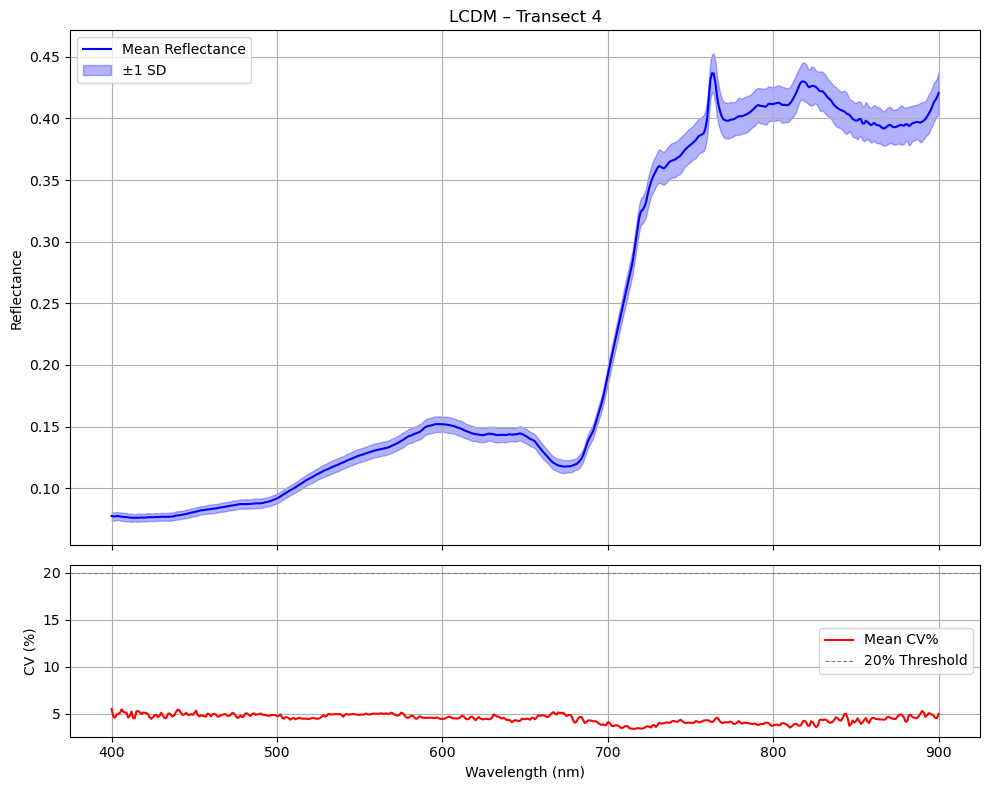

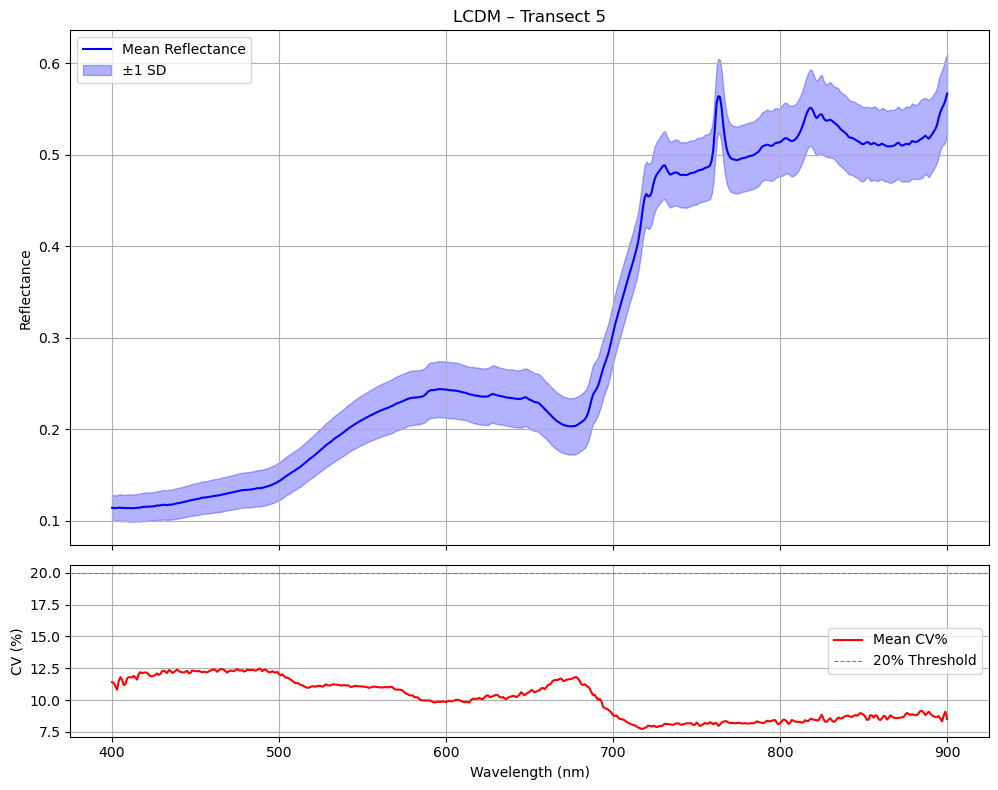

...

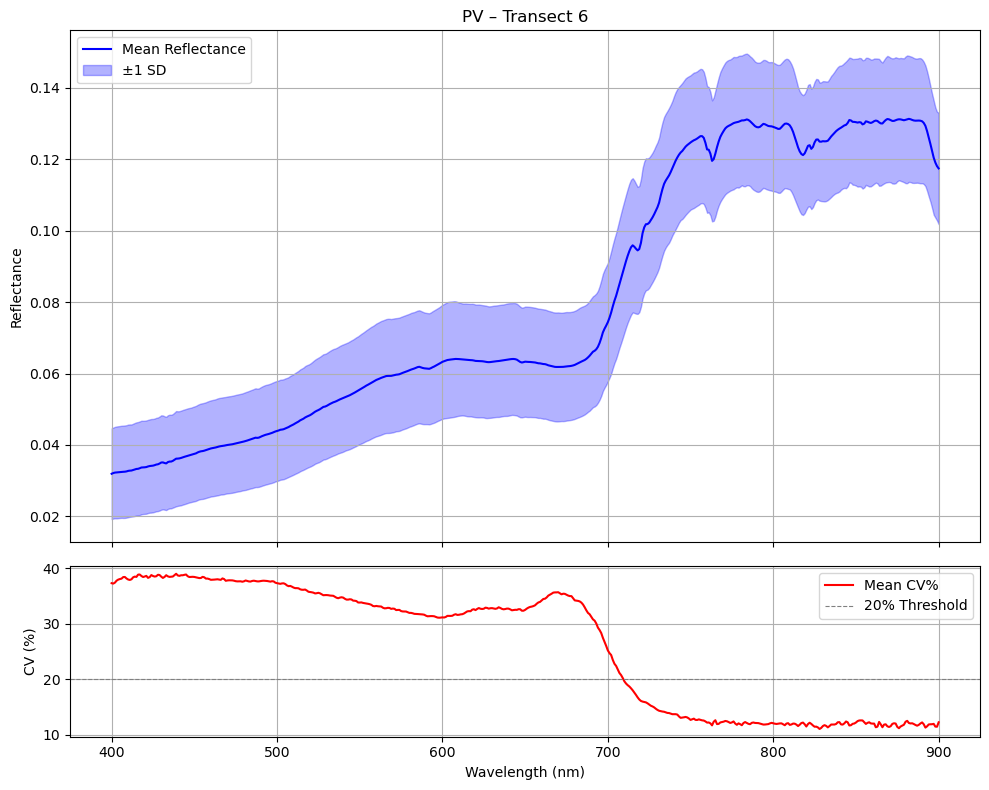

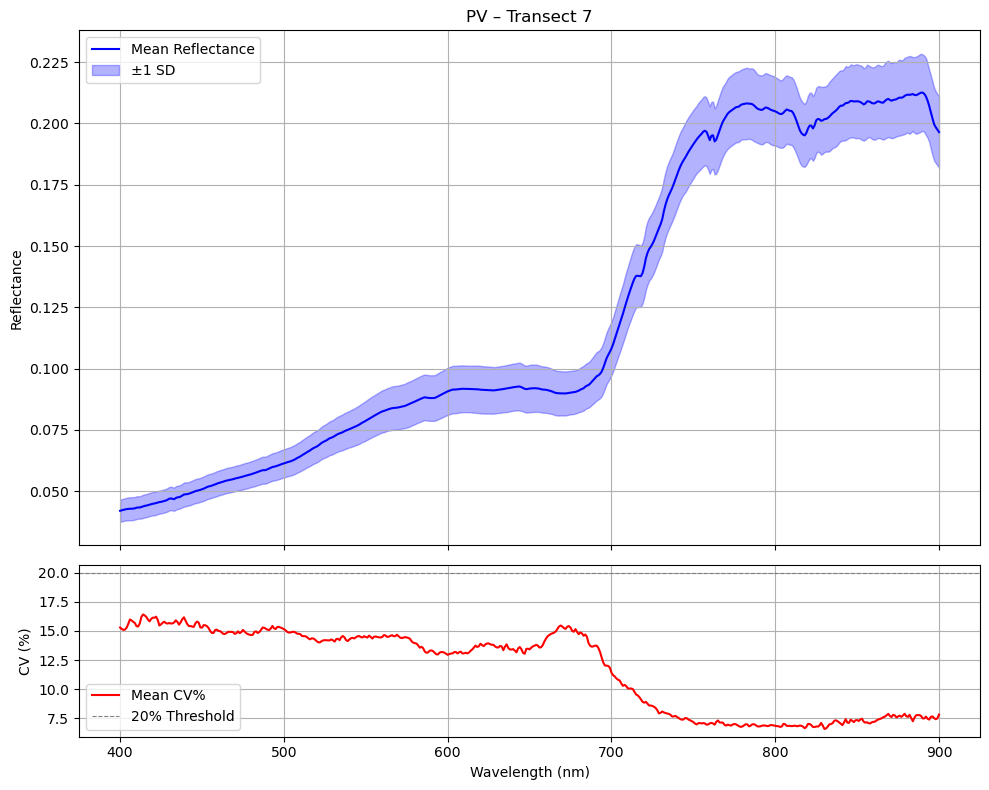

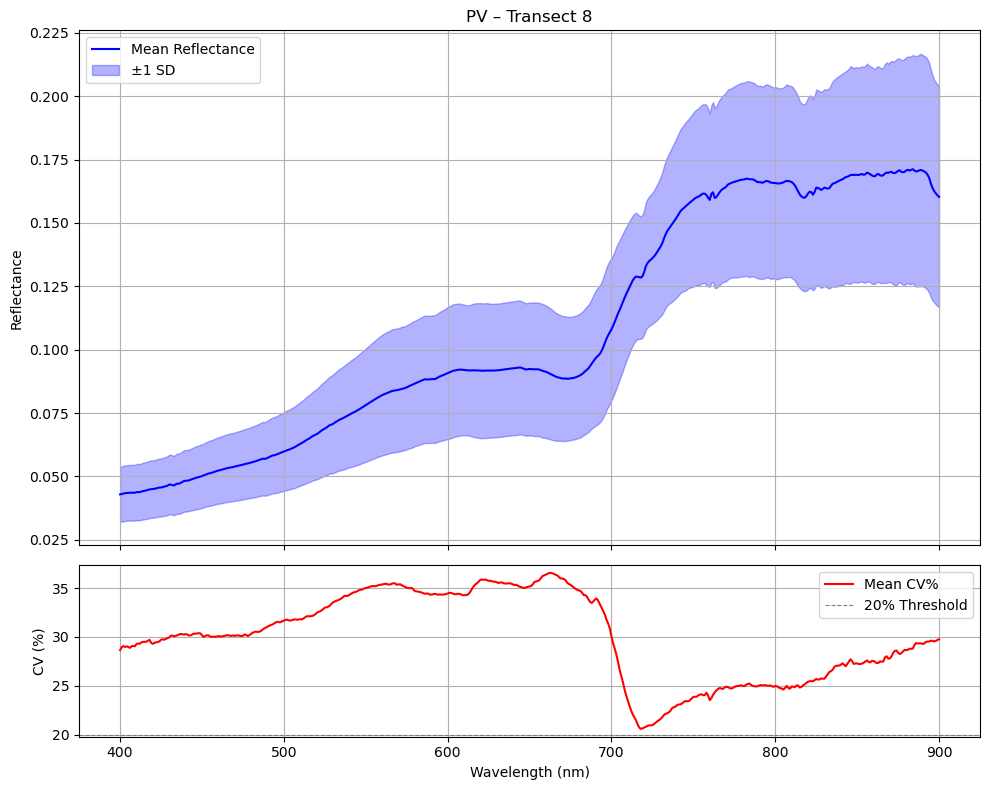

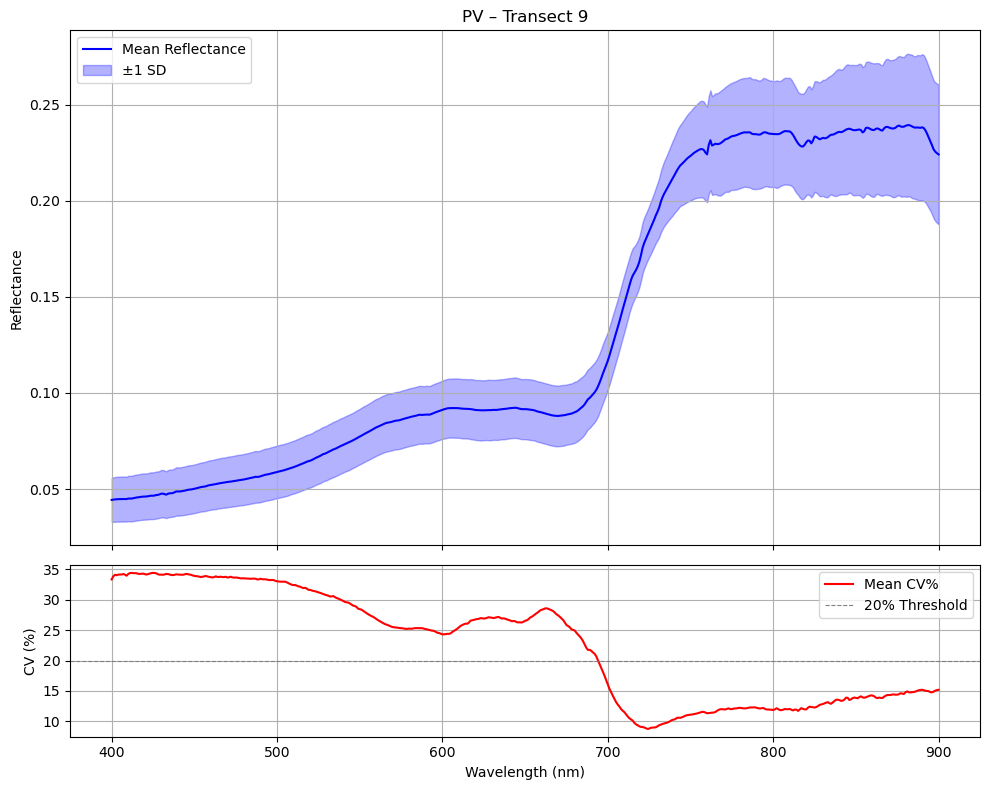

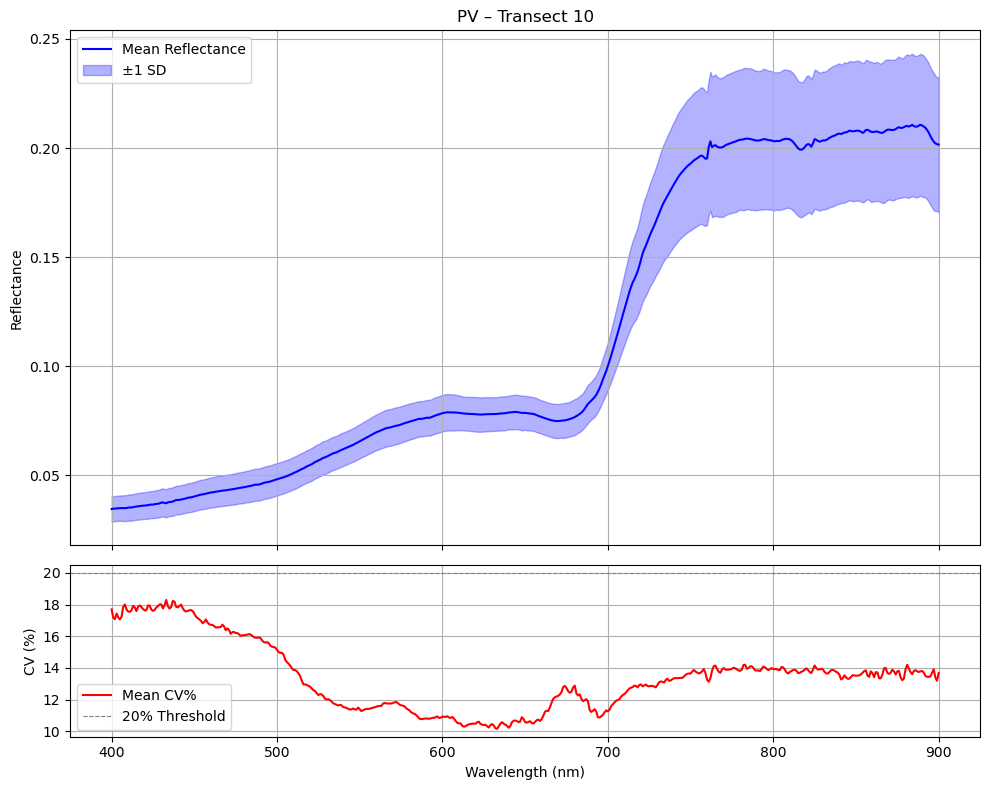

In [41]:
# Just display all quadrats in LCDM
plot_transect_with_stats(LCDM_summary, "LCDM")

# Save SD site quadrat plots as PNGs
plot_transect_with_stats(SD_summary, "SD")

# Save PV site quadrat plots as PDFs
plot_transect_with_stats(PV_summary, "PV")

In [39]:
#Plot stats by quadrat
import matplotlib.pyplot as plt

def plot_quadrats_with_stats(summary_df, site_name, show=True, save=False, output_dir=".", file_format="png"):
    """
    Plots one figure per quadrat in a site showing:
    - Mean reflectance ± 1 SD (top)
    - CV (%) (bottom)
    
    Parameters:
        summary_df (pd.DataFrame): Output of summarize_in_situ_data()
        site_name (str): e.g., "LCDM", "SD", "PV"
        show (bool): Show the plots in notebook
        save (bool): Save plots to file
        output_dir (str): Where to save files (if save=True)
        file_format (str): "png", "pdf", etc.
    """
    site_df = summary_df[summary_df["site"] == site_name]
    quadrats = sorted(site_df["quadrat"].unique())

    for q in quadrats:
        q_df = site_df[site_df["quadrat"] == q]

        if q_df.empty:
            continue

        # Aggregate just in case multiple wavelengths per quadrat
        grouped = (
            q_df
            .groupby("wavelength")
            .agg(
                mean_reflectance=("mean_reflectance", "mean"),
                std_reflectance=("std_reflectance", "mean"),
                mean_cv=("cv_percent", "mean")
            )
            .reset_index()
        )

        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True, height_ratios=[3, 1])

        # Top subplot: Reflectance ± SD
        # Convert to percentage
        mean_pct = grouped["mean_reflectance"] * 100
        std_pct = grouped["std_reflectance"] * 100

        # Top subplot: Reflectance ± SD (in %)
        ax1.plot(grouped["wavelength"], mean_pct, label="Mean Reflectance (%)", color='blue')
        ax1.fill_between(
            grouped["wavelength"],
            mean_pct - std_pct,
            mean_pct + std_pct,
            alpha=0.3,
            color='blue',
            label="±1 SD (%)"
        )
        ax1.set_ylabel("Reflectance (%)")
        transect_number = q_df["transect"].iloc[0]  # from data
        ax1.set_title(f"{site_name} – Transect {transect_number}, Quadrat {q}")
        ax1.grid(True)
        ax1.legend()

        # Bottom subplot: CV %
        ax2.plot(grouped["wavelength"], grouped["mean_cv"], label="CV%", color='red')
        ax2.axhline(20, linestyle="--", color="gray", linewidth=0.8, label="20% Threshold")
        ax2.set_ylabel("CV (%)")
        ax2.set_xlabel("Wavelength (nm)")
        ax2.grid(True)
        ax2.legend()

        plt.tight_layout()

        if save:
            filename = f"{site_name}_T{transect_number}_Q{q}.{file_format}"
            plt.savefig(f"{output_dir}/{filename}", dpi=300)
        if show:
            plt.show()
        else:
            plt.close()

            


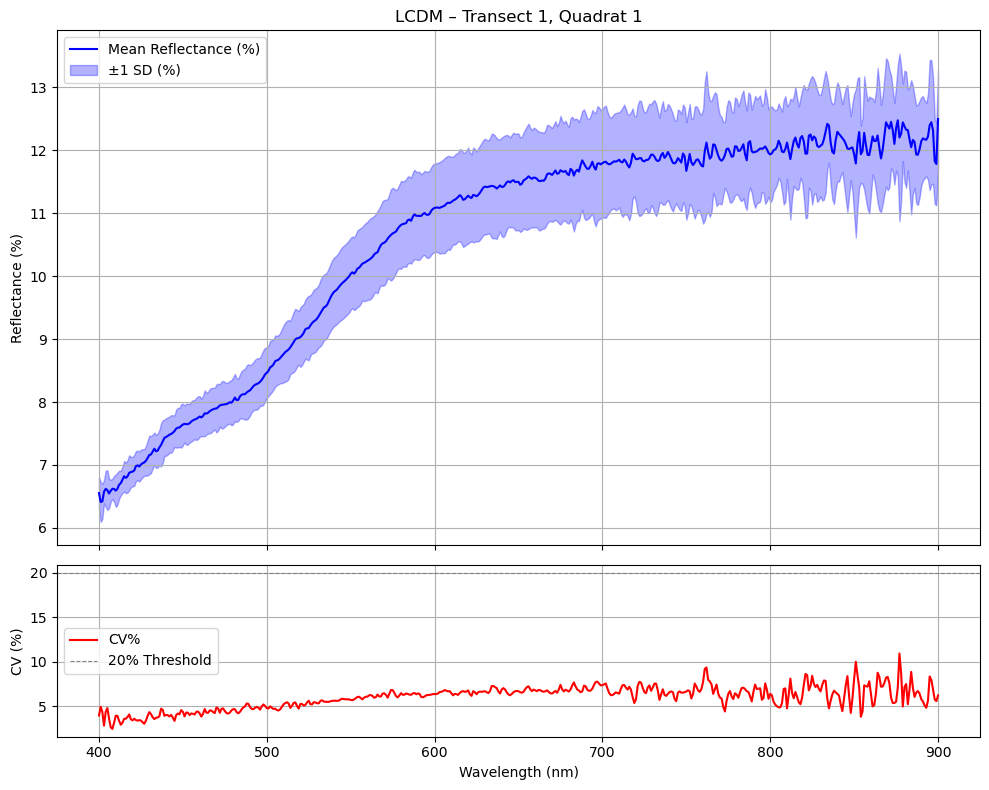

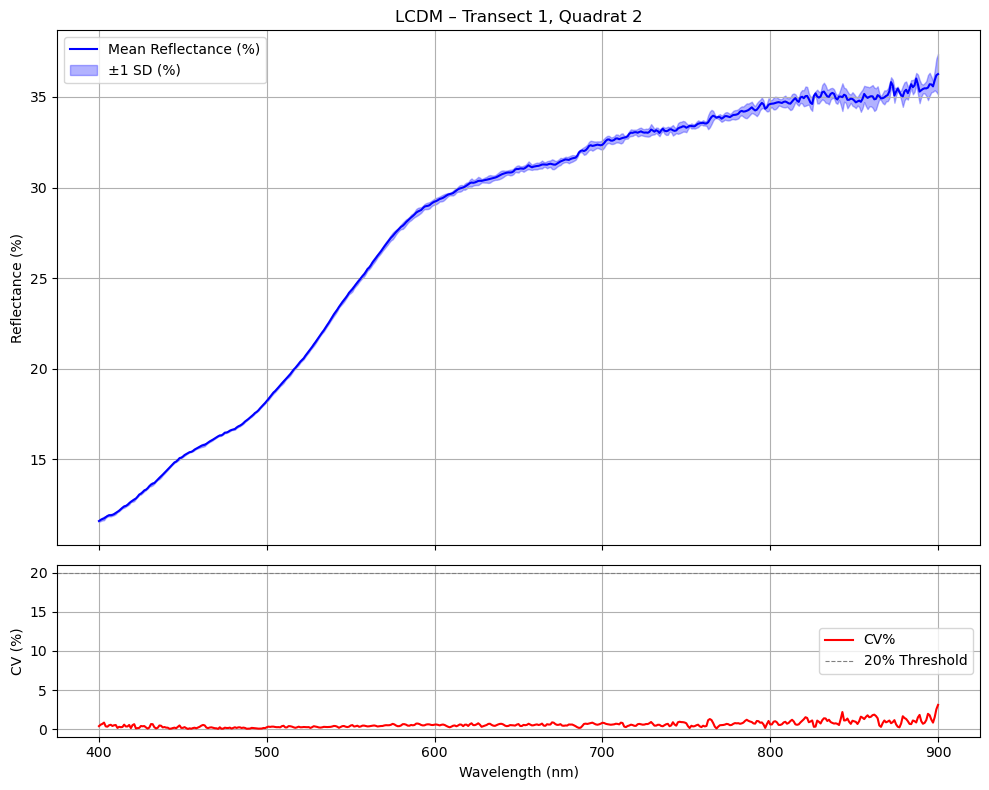

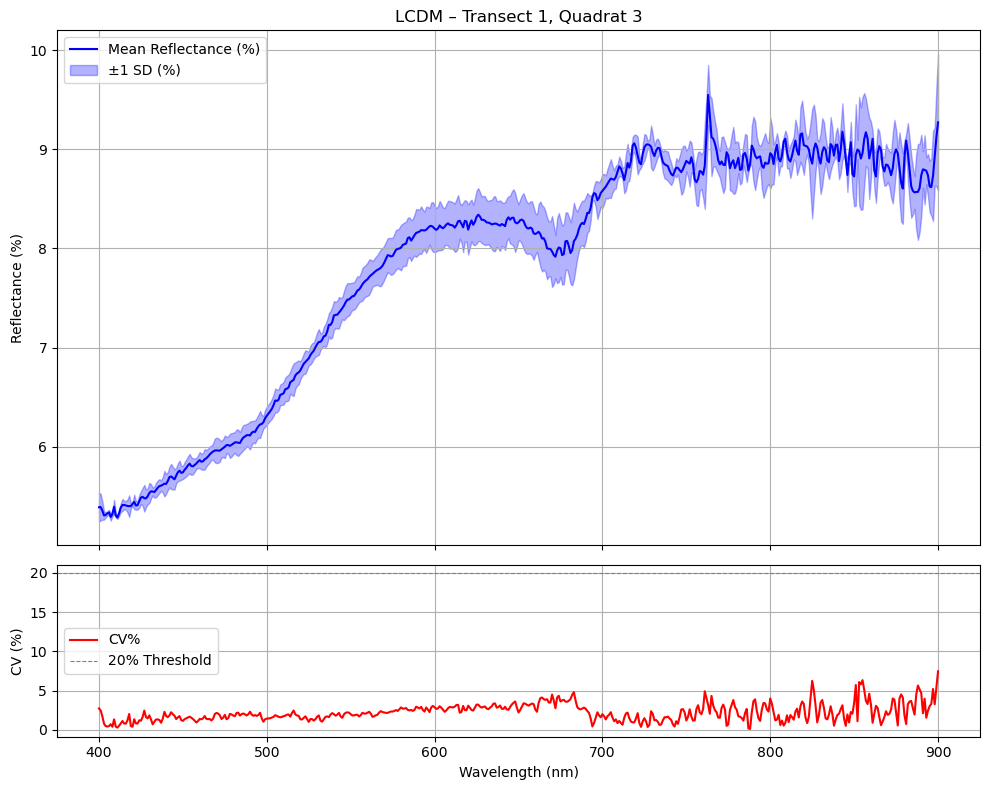

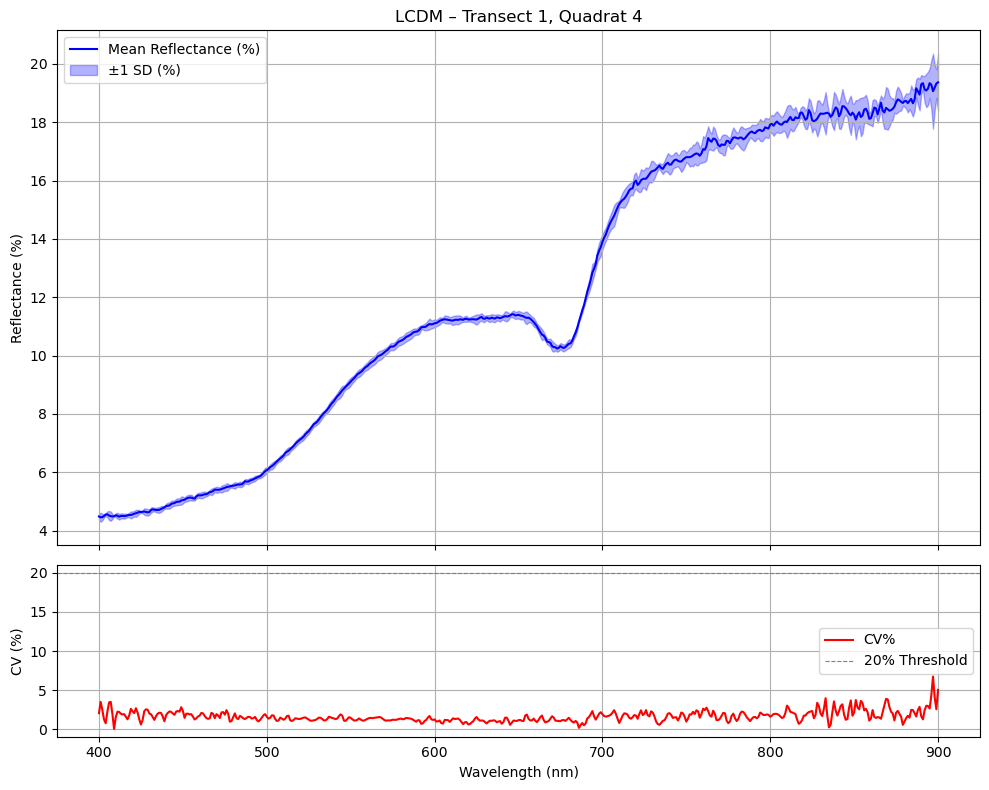

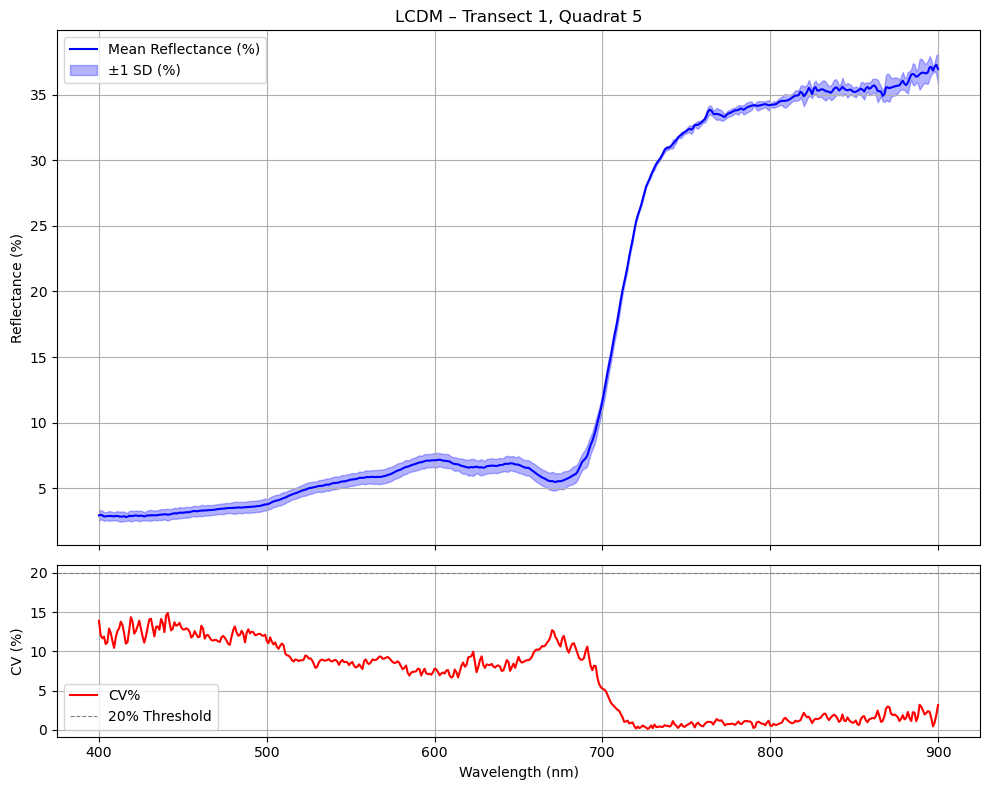

...

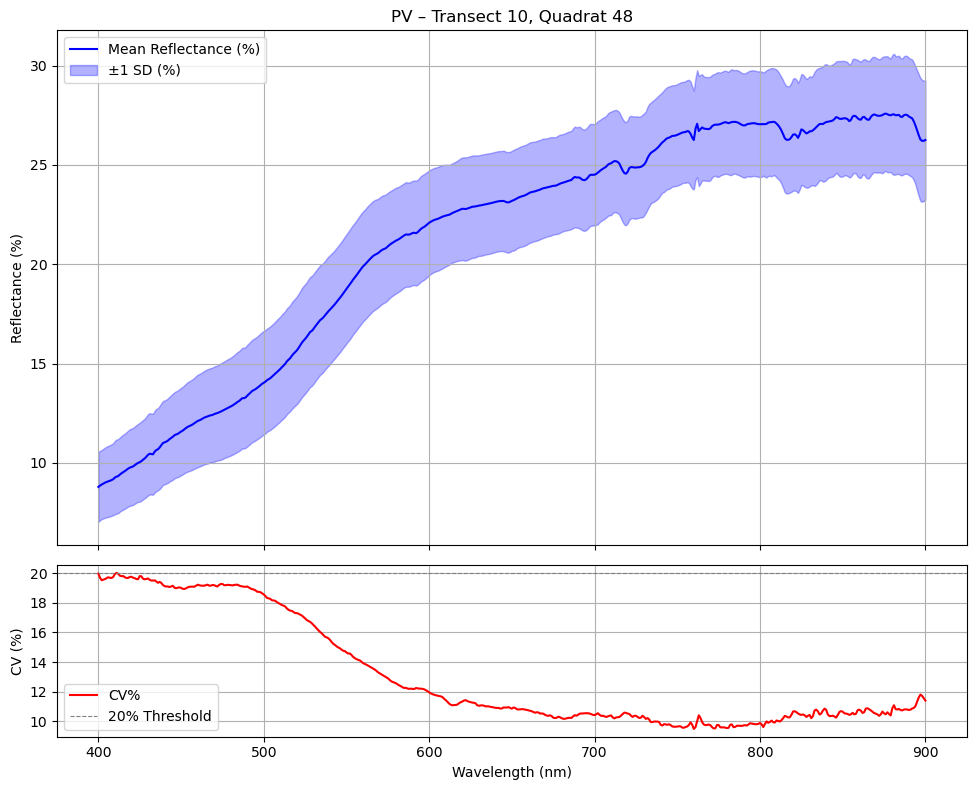

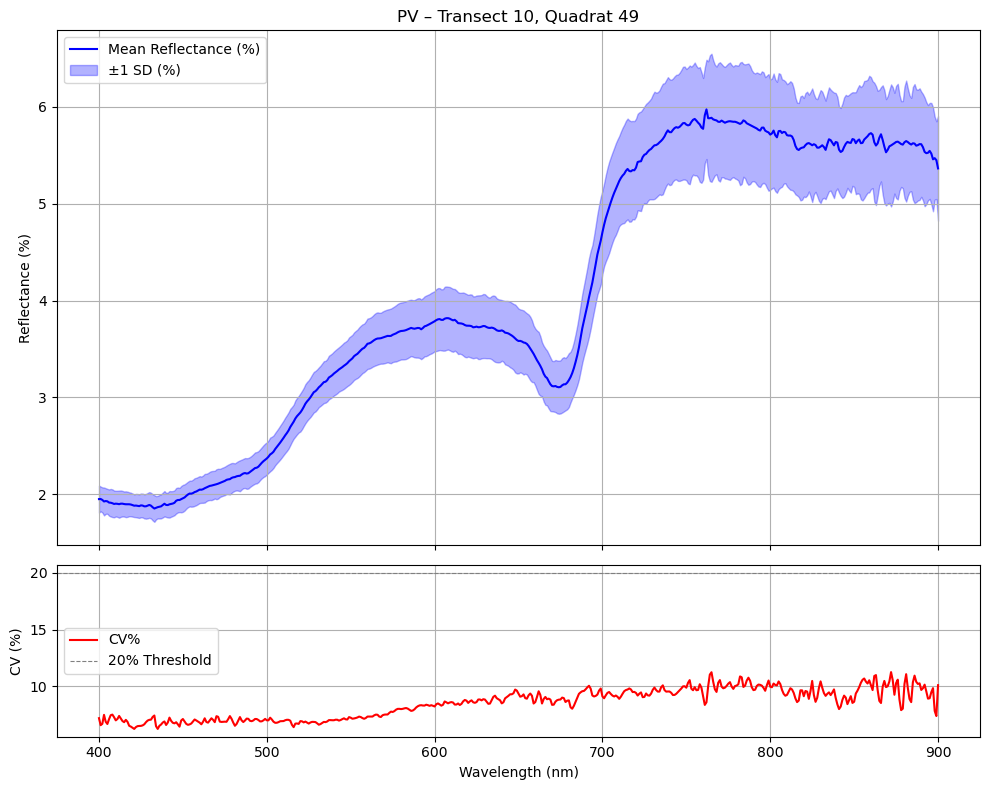

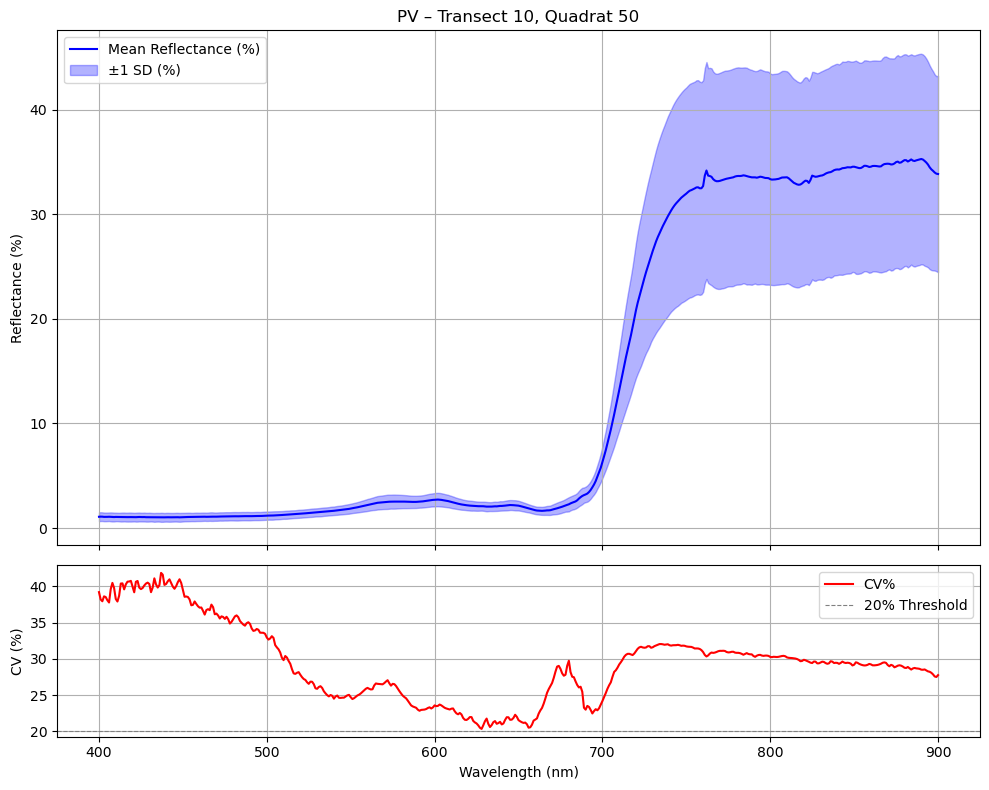

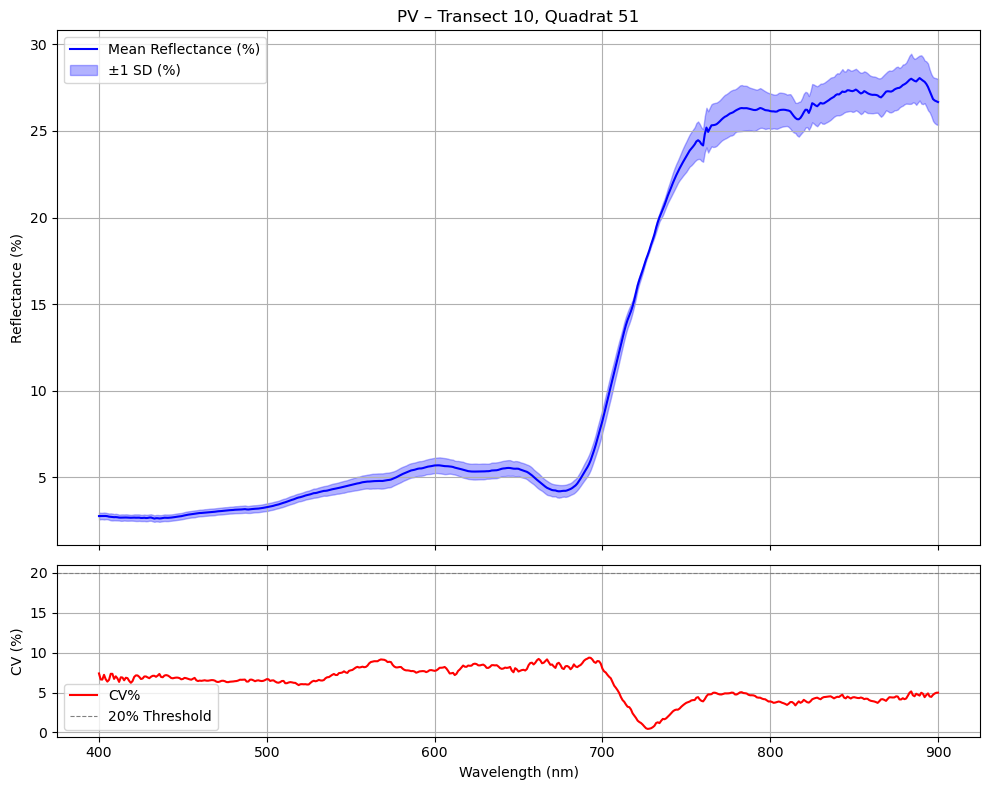

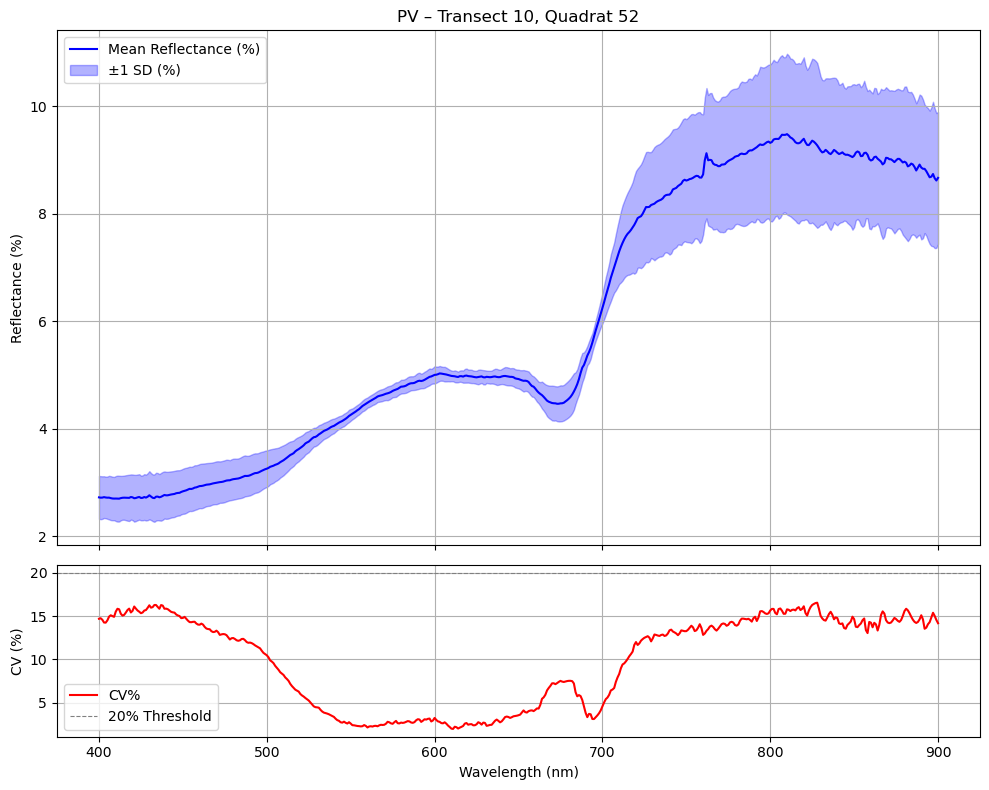

In [40]:
# Just display all quadrats in LCDM
plot_quadrats_with_stats(LCDM_summary, "LCDM")

# Save SD site quadrat plots as PNGs
plot_quadrats_with_stats(SD_summary, "SD")

# Save PV site quadrat plots as PDFs
plot_quadrats_with_stats(PV_summary, "PV")


### Optional: Save location outputs to pdf. 

In [ ]:

# #uncomment this code

# from matplotlib.backends.backend_pdf import PdfPages
# import matplotlib.pyplot as plt

# def save_all_quadrat_plots_to_pdf(summary_df, site_name, output_path="quadrat_summary.pdf"):
#     """
#     Saves all quadrat plots for a site into a single multi-page PDF.
#     Reflectance and standard deviation are plotted in percent.
#     """
#     site_df = summary_df[summary_df["site"] == site_name]
#     quadrats = sorted(site_df["quadrat"].unique())

#     with PdfPages(output_path) as pdf:
#         for q in quadrats:
#             q_df = site_df[site_df["quadrat"] == q]
#             if q_df.empty:
#                 continue

#             transect_number = q_df["transect"].iloc[0]

#             grouped = (
#                 q_df
#                 .groupby("wavelength")
#                 .agg(
#                     mean_reflectance=("mean_reflectance", "mean"),
#                     std_reflectance=("std_reflectance", "mean"),
#                     mean_cv=("cv_percent", "mean")
#                 )
#                 .reset_index()
#             )

#             # Convert mean and std reflectance to percentage
#             mean_pct = grouped["mean_reflectance"] * 100
#             std_pct = grouped["std_reflectance"] * 100

#             fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True, height_ratios=[3, 1])

#             # Top: Mean Reflectance ± SD (in %)
#             ax1.plot(grouped["wavelength"], mean_pct, color="blue", label="Mean Reflectance (%)")
#             ax1.fill_between(
#                 grouped["wavelength"],
#                 mean_pct - std_pct,
#                 mean_pct + std_pct,
#                 color="blue",
#                 alpha=0.3,
#                 label="±1 SD (%)"
#             )
#             ax1.set_ylabel("Reflectance (%)")
#             ax1.set_title(f"{site_name} – Transect {transect_number}, Quadrat {q}")
#             ax1.grid(True)
#             ax1.legend()

#             # Bottom: CV %
#             ax2.plot(grouped["wavelength"], grouped["mean_cv"], color="red", label="CV%")
#             ax2.axhline(20, linestyle="--", color="gray", linewidth=0.8, label="20% Threshold")
#             ax2.set_ylabel("CV (%)")
#             ax2.set_xlabel("Wavelength (nm)")
#             ax2.grid(True)
#             ax2.legend()

#             plt.tight_layout()
#             pdf.savefig(fig)  # Save the figure to the PDF
#             plt.close(fig)    # Free memory

# # Save outputs

# save_all_quadrat_plots_to_pdf(LCDM_summary, "LCDM", output_path="/Users/kylamonique/Desktop/JPLFiles/PythonCode/IntertidalOutputs/LCDM_all_quadrats.pdf")
# save_all_quadrat_plots_to_pdf(SD_summary, "SD", output_path="/Users/kylamonique/Desktop/JPLFiles/PythonCode/IntertidalOutputs/SD_all_quadrats.pdf")
# save_all_quadrat_plots_to_pdf(PV_summary, "PV", output_path="/Users/kylamonique/Desktop/JPLFiles/PythonCode/IntertidalOutputs/PV_all_quadrats.pdf")



## Part 6: Extract EMIT & ECOSTRESS Values at In Situ Quadrats. 

Use the quadrat geojson files to extract values from the raster data and identify regions of interest for ECOSTRESS and EMIT. 

In [ ]:
import geopandas as gpd

# Load your shape file again if not already defined
shape = gpd.read_file("/Users/kylamonique/Desktop/JPLFiles/SpectralEvolution/GIS/Waypoints/LCDMQuadrat.geojson")
shape = shape.to_crs("EPSG:4326")  # make sure CRS matches EMIT and ECOSTRESS

emit_quadrat_values = []
for idx, row in shape.iterrows():
    lon, lat = row.geometry.centroid.x, row.geometry.centroid.y
    pixel = emit_cropped.sel(longitude=lon, latitude=lat, method='nearest')
    spectrum = pixel.reflectance.values
    
    emit_quadrat_values.append({
        'quadrat_id': idx + 1,
        'longitude': lon,
        'latitude': lat,
        'spectrum': spectrum
    })

import pandas as pd
emit_df = pd.DataFrame(emit_quadrat_values)


In [ ]:
# Plot all quadrats in LCDM
plot_quadrats_in_site(LCDM_summary, site_name="LCDM")

# Plot  SD
plot_quadrats_in_site(SD_summary, site_name="SD")

# PV,
plot_quadrats_in_site(PV_summary, site_name="PV")


Fix LCDM Data

In [ ]:
# Get sorted take IDs for LCDM
LCDM_take_ids = (
    long_df[long_df["site"] == "LCDM"]
    .take_id.dropna()
    .sort_values()
    .unique()
    .tolist()
)

# Quadrats with only 2 takes
LCDM_custom_takes = {41: 2, 53: 2, 54: 2}

# Build take_id → quadrat map
LCDM_quadrat_map = build_quadrat_map(
    take_ids=LCDM_take_ids,
    n_quadrats=60,
    custom_take_counts=LCDM_custom_takes
)

# Add transect info
LCDM_quadrat_map = assign_transects(LCDM_quadrat_map, quadrats_per_transect=6)

# Merge with your melted LCDM data
LCDM_sorted = long_df[long_df["site"] == "LCDM"].copy()
LCDM_sorted = LCDM_sorted.merge(LCDM_quadrat_map, on="take_id", how="left")

# Preview the result
LCDM_sorted.head()



In [ ]:
#Confirm Results. 
print("Unique takes:", LCDM_sorted['take_id'].nunique()) 
print("Total rows:", len(LCDM_sorted))
print("Wavelengths per take (approx):", len(LCDM_sorted) // LCDM_sorted['take_id'].nunique())


In [ ]:
#Group and aggregate stats
LCDM_summary = (
    LCDM_sorted
    .groupby(['site', 'transect', 'quadrat', 'wavelength'])
    .agg(
        mean_reflectance=('reflectance', 'mean'),
        std_reflectance=('reflectance', 'std')
    )
    .reset_index()
)

#  Compute coefficient of variation (CV)
LCDM_summary['cv'] = (LCDM_summary['std_reflectance'] / LCDM_summary['mean_reflectance']) * 100


In [ ]:
#Save to a csv
LCDM_summary.to_csv("LCDM_summary.csv", index=False)

In [ ]:
LCDM_summary.query("quadrat == 1 and transect == 1").head(10)


In [ ]:
# def build_quadrat_map(site_name, n_quadrats, custom_take_counts=None):
#     """
#     Builds a list of quadrat numbers based on expected takes per quadrat.
    
#     Parameters:
#         site_name (str): Site name (for filtering)
#         n_quadrats (int): Total number of quadrats at the site
#         custom_take_counts (dict): Optional override {quadrat_number: num_takes}
    
#     Returns:
#         list: Quadrat number repeated by number of takes
#     """
#     take_counts = []
#     for i in range(1, n_quadrats + 1):
#         if custom_take_counts and i in custom_take_counts:
#             count = custom_take_counts[i]
#         else:
#             count = 3  # normal case
#         take_counts.extend([i] * count)
#     return take_counts


In [ ]:
# # Custom quadrat takes for LCDM
# LCDM_custom_takes = {41: 2, 53: 2, 54: 2}

# # Total takes = 177 → must match number of rows for LCDM in long_df
# LCDM_quadrats = build_quadrat_map("LCDM", 60, LCDM_custom_takes)

# # Filter and sort LCDM data
# LCDM_sorted = long_df[long_df["site"] == "LCDM"].sort_values("take_id").reset_index(drop=True)

# # Assign quadrat numbers
# LCDM_sorted["quadrat"] = LCDM_quadrats


# To Be Continued...

If you mess up, use the code below! - Use this for main project. 

In [ ]:
#Function to plot in situ data. 
def plot_avg_by_quadrat_list(
    df,
    start_col_index=6,
    quadrat_takes_list=None,  # e.g., [3, 3, 2, 2, 3, 3]
    sets_per_plot=6
):
    if quadrat_takes_list is None:
        raise ValueError("You must provide a list of takes per quadrat.")

    cols = df.columns[start_col_index:]
    group_labels = []
    group_cols_list = []

    i = 0
    quadrat_num = 1

    for takes in quadrat_takes_list:
        remaining_cols = cols[i:]

        if len(remaining_cols) < takes:
            print(f"Not enough columns for Quadrat {quadrat_num}, expected {takes}, found {len(remaining_cols)}.")
            break

        group_cols = remaining_cols[:takes]
        avg_label = f"Q{quadrat_num}_Avg_{group_cols[0]}_to_{group_cols[-1]}"
        df[avg_label] = df[group_cols].mean(axis=1)

        group_labels.append(avg_label)
        group_cols_list.append(avg_label)

        i += takes
        quadrat_num += 1

    # Plot in sets
    for plot_start in range(0, len(group_cols_list), sets_per_plot):
        plt.figure(figsize=(10, 6))
        for label in group_cols_list[plot_start:plot_start + sets_per_plot]:
            plt.plot(df["wavelength"], df[label], label=label)
        plt.xlabel("Wavelength (nm)")
        plt.ylabel("Average Normalized Reflectance")
        plt.title(f"LCDM Transects {plot_start // sets_per_plot + 1}")
        plt.legend()
        plt.grid(True)
        plt.show()


In [ ]:
#Use the function
# 20 quadrats total: quadrats 13 and 14 have only 2 takes, rest have 3
quadrat_takes = [3]*12 + [2, 2] + [3]*6

plot_avg_by_quadrat_list(
    ground_df,
    start_col_index=6,
    quadrat_takes_list=quadrat_takes,
    sets_per_plot=6
)


### Part  Streaming EMIT Data

To begin, open the text file with your ECOSTRESS / EMIT granules and read the URLs into a list. The list that will be printed out is a subset of scenes from the previous granule searches.

In [ ]:
# List the files in the required granules.txt
file_list = '/Users/kylamonique/Desktop/JPLFiles/PythonCode/required_granules.txt'
with open(file_list) as f: 
    urls = [line.rstrip('\n') for line in f]
urls

Next we need to start an fsspec https session, and use it to open the urls. This will allow us to access the data in the cloud like its part of our local file system. We’ll use this method to access the EMIT netCDF files, but a slightly different workflow for the ECOSTRESS data, which we will show later.

In [ ]:
# Get Https Session using Earthdata Login Info
fs = earthaccess.get_fsspec_https_session()

# Define Local Filepath
emit_fp = fs.open(urls[1])
emit_qa_fp = fs.open(urls[2])

### Part  Utilizing ECOSTRESS and EMIT Data

In order to perform an analysis on spectral reflectance and variability, you need data! Replace the file paths below with the appropriate file paths for your ECOSTRESS and EMIT data. Ideally, you would want the data to be from the same dates or within a close date range.